In [3]:
import h5py
import os
import numpy as np
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit
import cv2
import statistics
import skimage as ski
from skimage.morphology import square,disk
from scipy import signal
from scipy import stats
from pathlib import Path
import hashlib
import numbers
import matplotlib.colors as mcolors
import matplotlib.cm as cm

# Support Functions

In [4]:
def check_plunger_states(files, plengths=None):
    """
    Checks is plunger in the line, and which one.....
    """
    if plengths is None:

        plengths = [0.5, 1.5, 2.5, 3.5, 4.5, 5.5, 6.5, 7.5, 8.5, 9.5, 10.3]
        
    results = []

    for i, file_path in enumerate(files):
        
        plunger_state = 0
        plunger_in = None
        is_there_a_plunger = 0
 
        try:

            with h5py.File(file_path, 'r') as f:
                
                for p in range(len(plengths)):
                    try:
                        plunger = list(f['AwakeEventData'][f'AWAKE.XAWAV2_PE_P{p + 1}_ST']['PosSt']['value'])

                    except:
                        pass

                    else:
                        plunger_state = int(plunger[0])

                    try:
                        plunger = list(f['AwakeEventData'][f'AWAKE.XAWAV2_PG_P{p + 1}_ST']['PosSt']['value'])

                    except:
                        pass

                    else:
                        plunger_state = int(plunger[0])
                        

                    if plunger_state == 3 or plunger_state == 4:
                        plunger_in = p + 1
                        is_there_a_plunger = 1

                        break
 

        except Exception as e:
            print(f"Error reading file {file_path}: {e}")

            continue
 
        results.append({
            "index": i,
            "file": file_path,
            "is_there_a_plunger": bool(is_there_a_plunger),
            "plunger_in": plunger_in
        })

    return results

In [5]:
def fit_line(x,a,b):
    return a*x + b

In [6]:
def load_all_event_data(date,event_filename,spectro_no,threshold):
    
    with h5py.File('/eos/experiment/awake/event_data/'+date+'/'+ event_filename, 'r') as f:
        root = f['AwakeEventData']

        # Main data
        spectro_path = f'TCC4.SPECTRO{spectro_no}.DigiCam'

        try:
            data = root[spectro_path]['ExtractionImage']['image2D'][:]
            protons = root['TT41.BCTF.412340']['CaptureAcquisition']['totalIntensity'][0]
            
            ## sort BTV54
            screen_of_interest = root['TT41.BTV.412354.DigiCam']['ExtractionImage']['image2D'][400:610,510:720]
            bg_sensor = np.array(screen_of_interest) - 3.78126279
            w_median_filter = ski.filters.median(bg_sensor, footprint=disk(3)) 

            total_count = np.sum(w_median_filter)

            if protons !=0 and total_count > threshold:
                BTV54_position = 1

            else:
                BTV54_position = 0
                
                
            rif = root['Sps2AwakeSynchro']['ProtonDelayNs']['delay'][0]
            plunger_status = check_plunger_states(['/eos/experiment/awake/event_data/'+date+'/'+ event_filename])
            laser_firing = root['EMETER04']['Acq']['value'][0]

            ## sort based on threshold
            if laser_firing > 0.05:
                laser_value = 1

            else:
                laser_value = 0

            # Screens
            screens = {
                'OTR': root['MPP-VACTRANS-OTR']['Acquisition']['end_switch_plus_active'][()],
                'CTR': root['MPP-VACTRANS-CTR']['Acquisition']['end_switch_plus_active'][()],
                'LDBP': root['LBDP2']['Acq']['position'][0],
                'Plunger': plunger_status[0]['plunger_in'],
            }

                
        except(ValueError, KeyError):
            protons=0
            BTV54_position = 0
            data = np.zeros((1216,1936))
            screens = {'OTR': 0,
                'CTR': 0,
                'LDBP': 0,
                'Plunger': 0,}
            rif = 0 
            laser_value = 0 
    
    return data, protons, rif, laser_value, screens

In [7]:
def sort_by_space_scin_screen(space_x,space_y,start_events,end_events,Date,camera_number):
    
    y_step = int(680/space_x)
    x_step = int(1936/space_y)    
    
    list_indices_y = list(range(330, 1010, y_step))
    list_indices_x = list(range(0, 1936, x_step))
    
    rif_data = {}
    
    DATA_PATH = f'/eos/experiment/awake/event_data/{Date}'
    event_files = os.listdir(DATA_PATH)

    for i in np.arange(start_events,end_events,1):
        filename = event_files[i]
        
        data, protons, rif, laser, screens = load_all_event_data(Date,filename,spectro_no=camera_number,threshold=1750000)
        bg_sensor = np.array(data) - 3.78126279
        w_median_filter = ski.filters.median(bg_sensor, footprint=disk(4)) 
        
        if rif not in rif_data:
            rif_data[rif] = {}
            
        if laser not in rif_data[rif]:
             rif_data[rif][laser] = {}
            
        ## check what screens are in
        active_screens = []
        list_screens = ['OTR','CTR','BTV50','BTV53', 'BTV426', 'BTV442', 'LDBP','Plunger', 'BTV54']

        # Determine which screen is active
        screen_used = None
        for screen in list_screens: 
            val = screens.get(screen,None)

            if screen =='LDBP':
                val = screens['LDBP']
                if val == 0:
                    active_screens.append('LDBP')

            elif screen == 'Plunger':
                val = screens['Plunger']

                for j in np.arange(1,11,1):
                    if val == j:
                        active_screens.append(f'Plunger{j}')                

            elif isinstance(val, (bool, np.bool_)):
                if val == False:
                    active_screens.append(screen)
 
            elif isinstance(val, numbers.Number):
                if float(val) == 1:
                    active_screens.append(screen)

                    
        if not active_screens:
            active_screens = ['None']

        # Create a combined label
        screen_label = '+'.join(active_screens)

        if screen_label not in rif_data[rif][laser]:
            rif_data[rif][laser][screen_label] = {'full_image': {'fit_parameters': [], 'proton_count': [] }}
            
            
            
        ## Add full camera image
        rif_data[rif][laser][screen_label]['full_image']['fit_parameters'].append(np.mean(w_median_filter[330:990,60:]))
        rif_data[rif][laser][screen_label]['full_image']['proton_count'].append(protons)

        for i in list_indices_y:
            for j in list_indices_x:        
                sliced_data = w_median_filter[i:i+y_step,j:j+x_step]
                #print(np.mean(sliced_data))

                index_cut = (i, i+y_step , j, j+x_step)

                if index_cut not in rif_data[rif][laser][screen_label]:
                    rif_data[rif][laser][screen_label][index_cut] = {
                        'fit_parameters': [], 'proton_count': []}

                rif_data[rif][laser][screen_label][index_cut]['fit_parameters'].append(np.mean(sliced_data))
                rif_data[rif][laser][screen_label][index_cut]['proton_count'].append(protons)


    return rif_data

In [8]:
def fit_to_spectrometer(rif_data, no_events, Date, camera_number):
    saved_slopes_intercepts = {}
    list_rifs = list(rif_data)
    
    for rif in list_rifs:
        list_laser_values = list(rif_data[rif])
        
        for laser in list_laser_values:
            list_screen_combos = list(rif_data[rif][laser])

            for screen_label in list_screen_combos:
                data = rif_data[rif][laser][screen_label]
                index_count = list(data)

                list_slopes = []
                list_int = []
                slope_heat_map = np.zeros((1216, 1936))
                intercept_heat_map = np.zeros((1216, 1936))

                for i in index_count:
                    x = np.array(data[i]['proton_count'])  
                    y = np.array(data[i]['fit_parameters'])

                    mean_x = np.mean(x)
                    mean_y = np.mean(y)

                    std_x = np.std(x)
                    std_y = np.std(y)

                    mask = (np.abs(x - mean_x) <= 2 * std_x) & (np.abs(y - mean_y) <= 2 * std_y)

                    # Filter out outliers > 2 std deviations
                    filtered_x = x[mask]
                    filtered_y = y[mask]            

                    if len(filtered_x) >= 3 and i != 'full_image':  # Curve fitting requires at least two data points
                        params = curve_fit(fit_line, filtered_x, filtered_y)[0]
                        a, b = params
                        list_slopes.append(a)
                        list_int.append(b)

                        slope_heat_map[i[0]:i[1],i[2]:i[3]] = a 
                        intercept_heat_map[i[0]:i[1],i[2]:i[3]] = b

                # Compute MAD
                slopes_array = np.array(list_slopes)
                intercepts_array = np.array(list_int)


                median_slope = np.median(slopes_array)
                abs_deviation = np.abs(slopes_array-median_slope)
                mad_slope =  np.median(abs_deviation)

                median_int = np.median(intercepts_array)
                abs_deviation_int = np.abs(intercepts_array-median_int)
                mad_int =  np.median(abs_deviation_int)


                # Filter out outliers > 2 MAD
                filtered_slopes = slopes_array[np.abs(slopes_array - median_slope) <= 2 * mad_slope]
                filtered_intercepts = intercepts_array[np.abs(intercepts_array - median_int) <= 2 * mad_int]

                filtered_slope_map = np.zeros((1216, 1936))
                filtered_intercept_map = np.zeros((1216, 1936))

                slope_mask = (np.abs(slope_heat_map - median_slope) <= 2 * mad_slope) 
                intercept_mask = (np.abs(intercept_heat_map - median_int) <= 2 * mad_int) 

                # Apply masks
                filtered_slope_map[slope_mask] = slope_heat_map[slope_mask]
                filtered_intercept_map[intercept_mask] = intercept_heat_map[intercept_mask]

                ## write to dictionary
                key = f"RIF_{rif}_Laser_{laser}_Screens_{screen_label}"
                saved_slopes_intercepts[f"{key}_slope"] = filtered_slope_map
                saved_slopes_intercepts[f"{key}_intercepts"] = filtered_intercept_map
                
    date_format = Date.replace('/','-')
    np.savez_compressed(f"slope_intercept_data_{date_format}_Spectro_{camera_number}_Upto_Event_{no_events}.npz",**saved_slopes_intercepts)
    
    return 'Your dataset has been saved'

In [9]:
def check_screens(screens):

    active_screens = []
    list_screens = ['OTR','CTR','BTV50','BTV53', 'BTV426', 'BTV442', 'LDBP','Plunger', 'BTV54']

    # Determine which screen is active
    screen_used = None
    for screen in list_screens: 
        val = screens.get(screen,None)

        if screen =='LDBP':
            val = screens['LDBP']
            if val == 0:
                active_screens.append('LDBP')

        elif screen == 'Plunger':
            val = screens['Plunger']

            for j in np.arange(1,11,1):
                if val == j:
                    active_screens.append(f'Plunger{j}')                

        elif isinstance(val, (bool, np.bool_)):
            if val == False:
                active_screens.append(screen)

        elif isinstance(val, numbers.Number):
            if float(val) == 1:
                active_screens.append(screen)


    if not active_screens:
        active_screens = ['None']

    # Create a combined label
    screen_label = '+'.join(active_screens)
    return screen_label

# Subtraction Function

In [11]:
def background_subtraction(Date, event, camera_number, threshold):
    
    ## load data
    event_files = os.listdir(f'/eos/experiment/awake/event_data/{Date}')
    data, protons, rif, laser, screens = load_all_event_data(Date,event_files[event],spectro_no=camera_number,threshold=1.3e6)
    
    ## remove electronic noise and median filter
    #bg_sensor = np.array(data) - 3.78126279
    #data_w_median_filter = ski.filters.median(bg_sensor, footprint=disk(4)) 
    
    screen_label = check_screens(screens)
    
    date_format = Date.replace('/','-')
        
    m_c_data = np.load(f"slope_intercept_data_{date_format}_Spectro_{camera_number}_Upto_Event_4.npz")
    slopes = m_c_data[f"RIF_{rif}_Laser_0_Screens_{screen_label}_slope"]
    intercepts = m_c_data[f"RIF_{rif}_Laser_0_Screens_{screen_label}_intercepts"]
    
    background = slopes*protons + intercepts
    print("Shapes - slopes:", slopes.shape, "intercepts:", intercepts.shape, "data:", data.shape)
    print("Protons:", protons)

    cleaned_image = data - background
    
    return cleaned_image

## Test some initial data sets

In [12]:
### 17/05/2025

In [54]:
spectro_1_17_05 = sort_by_space_scin_screen(15,14,100,'2025/05/17',1)

In [55]:
fit_to_spectrometer(spectro_1_17_05,100,'2025/05/17',1)

/tmp/ipykernel_603/1446012840.py:37: OptimizeWarning: Covariance of the parameters could not be estimated
  params = curve_fit(fit_line, filtered_x, filtered_y)[0]


'Your dataset has been saved'

In [56]:
background_ex = background_subtraction('2025/05/17',50, 1, threshold=1.75e6)

In [10]:
Date = '2024/09/14'
DATA_PATH = f'/eos/experiment/awake/event_data/{Date}'
event_files = os.listdir(DATA_PATH)
len(event_files)
print(event_files[963])

1726318911735000000_Type0_2064_2.h5


In [95]:
## run 2062
## 14-09-2024 14:55:48
## CET +1 to UTC => (- 2 hrs)

In [191]:
event_files[962]

'1726318890135000000_Type0_2064_1.h5'

In [127]:
event_files[9]

'1726318846935000000_Type0_2063_5.h5'

In [94]:
import time

epoch_time = 1726318544  # Replace with your epoch time

formatted_time = time.strftime('%Y-%m-%d %H:%M:%S', time.gmtime(epoch_time))
print(formatted_time)

2024-09-14 12:55:44


In [41]:
ex_data, protons, rif, laser, screens = load_all_event_data('2024/09/14',event_files[963],spectro_no=2,threshold=1750000)
print(screens)

{'OTR': True, 'CTR': True, 'LDBP': 0, 'Plunger': None}


## Case 2 

In [30]:
test_14_09_w_LBDP = sort_by_space_scin_screen(660,1876,1159,1163,'2024/09/14',2)

In [31]:
fit_to_spectrometer(test_14_09_w_LBDP,4,'2024/09/14',2)

/tmp/ipykernel_469/1446012840.py:37: OptimizeWarning: Covariance of the parameters could not be estimated
  params = curve_fit(fit_line, filtered_x, filtered_y)[0]


'Your dataset has been saved'

In [223]:
data =  np.load(f"slope_intercept_data_2024-09-14_Spectro_2_Upto_Event_4.npz")
print(data.files)

['RIF_1121740.937_Laser_0_Screens_LDBP_slope', 'RIF_1121740.937_Laser_0_Screens_LDBP_intercepts']


In [37]:
background_ex_ldbp = background_subtraction('2024/09/14',963, 2, threshold=1.75e6)

Shapes - slopes: (1216, 1936) intercepts: (1216, 1936) data: (1216, 1936)
Protons: 29.135962


Text(0.5, 1.0, 'Unfiltered Image, Event 963, 14.09.24')

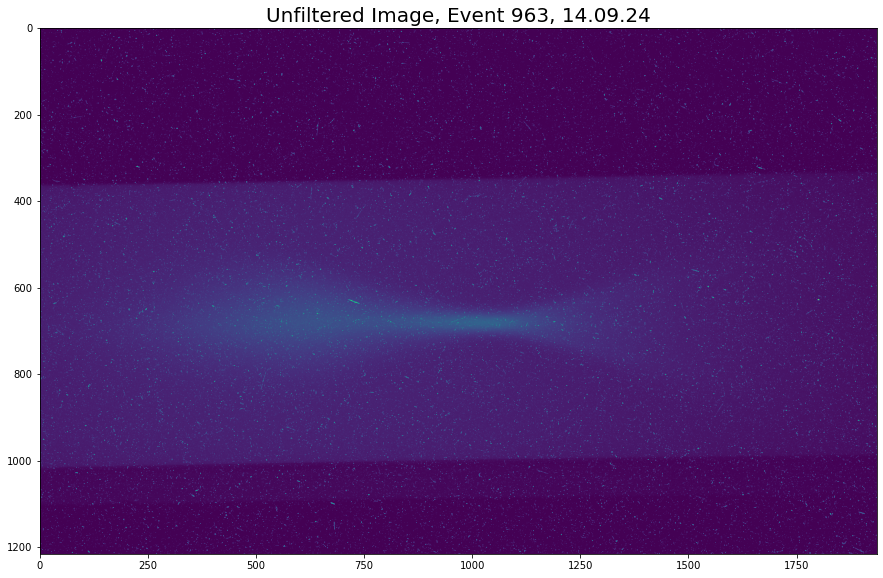

In [226]:
plt.figure(figsize=(15,10))
plt.imshow(ex_data,vmax=4095)
plt.title('Unfiltered Image, Event 963, 14.09.24',fontsize=20)

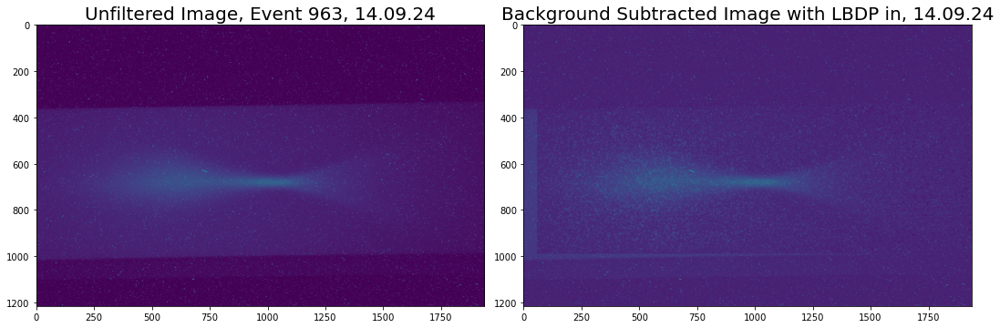

In [42]:
fig, axes = plt.subplots(1, 2, figsize=(15, 10))

# First subplot
axes[0].imshow(ex_data, vmax=4095)
axes[0].set_title('Unfiltered Image, Event 963, 14.09.24', fontsize=20)

# Second subplot
axes[1].imshow(background_ex_ldbp, vmax=4095)
axes[1].set_title('Background Subtracted Image with LBDP in, 14.09.24', fontsize=20)

plt.tight_layout()
plt.show()

In [238]:
ex_data_975, protons, rif, laser, screens = load_all_event_data('2024/09/14',event_files[975],spectro_no=2,threshold=1750000)
background_ex_ldbp_975 = background_subtraction('2024/09/14',975, 2, threshold=1.75e6)

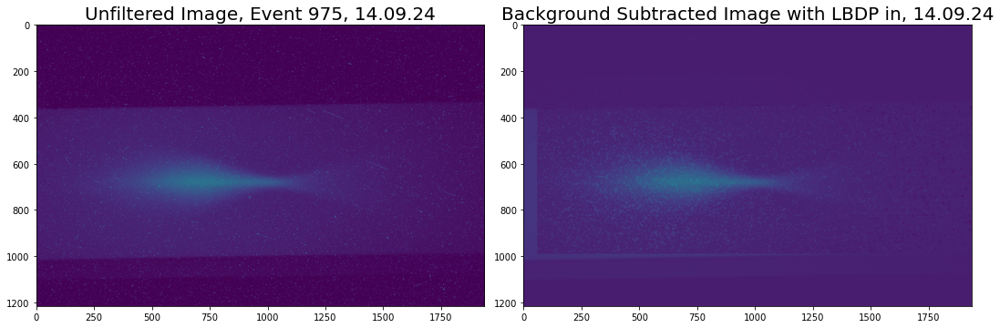

In [239]:
fig, axes = plt.subplots(1, 2, figsize=(15, 10))

# First subplot
axes[0].imshow(ex_data_975, vmax=4095)
axes[0].set_title('Unfiltered Image, Event 975, 14.09.24', fontsize=20)

# Second subplot
axes[1].imshow(background_ex_ldbp_975, vmax=4095)
axes[1].set_title('Background Subtracted Image with LBDP in, 14.09.24', fontsize=20)

plt.tight_layout()
plt.show()

In [44]:
ex_data_962, protons, rif, laser, screens = load_all_event_data('2024/09/14',event_files[962],spectro_no=2,threshold=1750000)
background_ex_ldbp_962 = background_subtraction('2024/09/14',962, 2, threshold=1.75e6)

Shapes - slopes: (1216, 1936) intercepts: (1216, 1936) data: (1216, 1936)
Protons: 29.200354


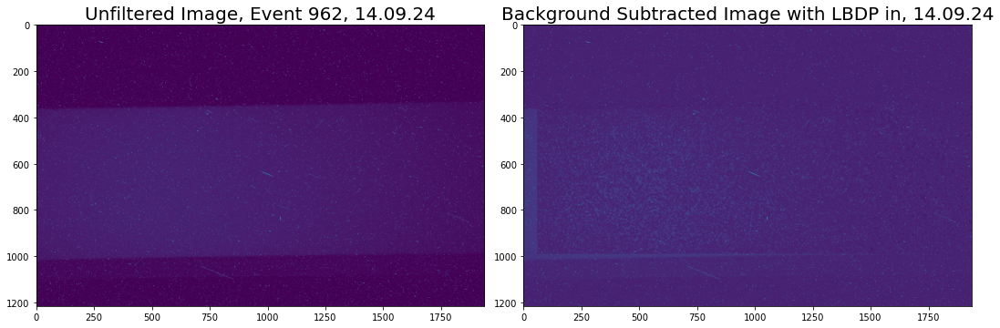

In [45]:
fig, axes = plt.subplots(1, 2, figsize=(15, 10))

# First subplot
axes[0].imshow(ex_data_962, vmax=4095)
axes[0].set_title('Unfiltered Image, Event 962, 14.09.24', fontsize=20)

# Second subplot
axes[1].imshow(background_ex_ldbp_962, vmax=4095)
axes[1].set_title('Background Subtracted Image with LBDP in, 14.09.24', fontsize=20)

plt.tight_layout()
plt.show()

In [114]:
def plot_fit_lines(Date, event, camera_number, threshold):
    
    ## load data
    event_files = os.listdir(f'/eos/experiment/awake/event_data/{Date}')
    data, protons, rif, laser, screens = load_all_event_data(Date,event_files[event],spectro_no=camera_number,threshold=1.3e6)
    
    ## remove electronic noise and median filter
    bg_sensor = np.array(data) - 3.78126279
    data_w_median_filter = ski.filters.median(bg_sensor, footprint=disk(4)) 
    
    screen_label = check_screens(screens)
    
    date_format = Date.replace('/','-')
        
    m_c_data = np.load(f"slope_intercept_data_{date_format}_Spectro_{camera_number}_Upto_Event_4_nofilter.npz")
    slopes = m_c_data[f"RIF_{rif}_Laser_0_Screens_{screen_label}_slope"]
    intercepts = m_c_data[f"RIF_{rif}_Laser_0_Screens_{screen_label}_intercepts"]
    
    background = slopes*protons + intercepts
    print("Shapes - slopes:", slopes.shape, "intercepts:", intercepts.shape, "data:", bg_sensor.shape)
    print("Protons:", protons)
    
    plt.imshow(background)
    print(background)

Shapes - slopes: (1216, 1936) intercepts: (1216, 1936) data: (1216, 1936)
Protons: 29.135962
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]


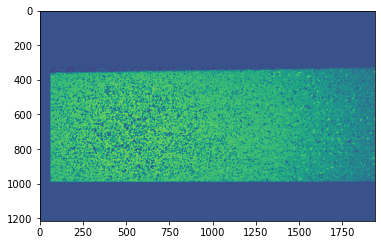

In [43]:
plot_fit_lines('2024/09/14',963, 2, threshold=1.75e6)

In [9]:
## look at some lines for 210 case

In [9]:
def get_no_colours(n,cmap_name='viridis'):
   
    cmap = cm.get_cmap(cmap_name,n)
    return [mcolors.to_hex(cmap(i/max(n-1,1))) for i in range(n)]

In [16]:
def plot_spatially_sliced2(n,rif_data):
    fig, ax = plt.subplots(figsize=(10, 6))
    fig2, ax2 = plt.subplots(figsize=(10, 6))
    fig3, ax3 = plt.subplots(figsize=(10, 6))
    plotted_labels = set()
    
    data = rif_data[1121740.937][0]['LDBP']
    index_count = list(rif_data[1121740.937][0]['LDBP'])

    colour_distinct_list = get_no_colours(n ,cmap_name='viridis')
    
    list_slopes = []
    slopes_mean = []
    slope_heat_map = np.zeros((1216, 1936))
    intercept_heat_map = np.zeros((1216, 1936))

    for i,n in zip(index_count, np.arange(0,len(colour_distinct_list),1)):
        colour = colour_distinct_list[n]
        show_label = i not in plotted_labels

        x = np.array(data[i]['fit_parameters'])
        y = np.array(data[i]['proton_count'])
        #ax.scatter(x, y,color=colour, label=i if show_label else None)
        plotted_labels.add(i)


        if len(x) >= 3 and i != 'full_image':  # Curve fitting requires at least two data points
            a_guess,b_guess = np.polyfit(x,y,1)
            params = curve_fit(fit_line, np.sort(x), np.sort(y),p0=[a_guess,b_guess])[0]
            a, b = params
            list_slopes.append({"slope": a,"camera section": i})#, "colour": colour})
            slopes_mean.append(a)

            #x_fitted = np.linspace(0,np.max(x)+.005*np.max(x),1000)
            #y_fitted = fit_line(x_fitted,a,b)
            #ax.plot(x_fitted, y_fitted, '--', color=colour, alpha=0.8)

            slope_heat_map[i[0]:i[1],i[2]:i[3]] = a 
            intercept_heat_map[i[0]:i[1],i[2]:i[3]] = b


    #print(list_slopes)
    #print(np.mean(slopes_mean[1:]))


    #ax.set_title(f'RIF Offset = {round(rif - 1132482.599, 4)},   Screens In = {screen_label}' , fontsize=16)
    ax.set_xlabel('Mean Pixel Intensity', fontsize=14)
    ax.set_ylabel('Proton Bunch Density', fontsize=14)
    ax.grid()
    #ax.set_ylim(0,31)

    #ax.legend(title="Position", loc='best')

    im = ax2.imshow(slope_heat_map,cmap='viridis',origin='upper')
    ax2.imshow(slope_heat_map)
    fig2.colorbar(im, ax=ax2, label ='Slope')

    ax2.set_title(f'Slope Heat Map. RIF =  +{round(1121740.937 - 1121740.837, 4)}ps,   Screens In = LBDP2' , fontsize=16)
    ax2.set_xlabel('X Pixels', fontsize=14)
    ax2.set_ylabel('Y Pixels', fontsize=14)

    im2 = ax3.imshow(intercept_heat_map,cmap='Blues',origin='upper')
    ax3.set_title(f'Y Intercept Heat Map. RIF = +{round(1121740.937 - 1121740.837, 4)}ps,   Screens In = LBDP2' , fontsize=16)
    ax3.imshow(intercept_heat_map,cmap='Blues')
    fig3.colorbar(im2, ax=ax3, label ='Y int')
    ax3.set_xlabel('X Pixels', fontsize=14)
    ax3.set_ylabel('Y Pixels', fontsize=14)

    plt.tight_layout()
    plt.show()

In [11]:
test_14_09_w_LBDP_210 = sort_by_space_scin_screen(15,14,1159,1163,'2024/09/14',2)

In [15]:
#list(test_14_09_w_LBDP_210[1121740.937][0]['LDBP'])

In [26]:
test_14_09_w_LBDP_100000 = sort_by_space_scin_screen(660,1876,1159,1163,'2024/09/14',2)

# CASE 1

1121740.937 {'OTR': True, 'CTR': True, 'LDBP': 2, 'Plunger': None}


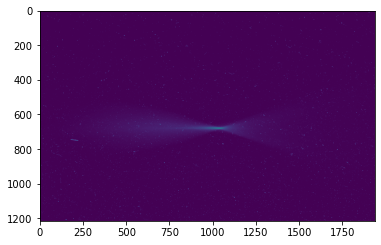

In [125]:
ex_data, protons, rif, laser, screens = load_all_event_data('2024/09/14',event_files[950],spectro_no=2,threshold=1750000)
print(rif,screens)
plt.imshow(ex_data)

1121740.937 {'OTR': True, 'CTR': True, 'LDBP': 2, 'Plunger': None} 1 930


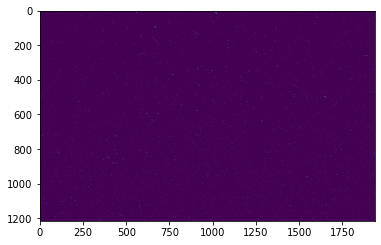

1121740.937 {'OTR': True, 'CTR': True, 'LDBP': 2, 'Plunger': None} 1 931


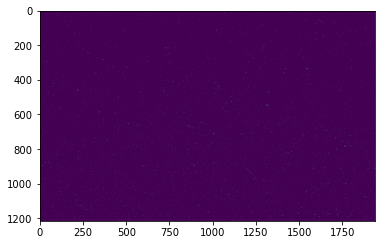

1121740.937 {'OTR': True, 'CTR': True, 'LDBP': 2, 'Plunger': None} 1 932


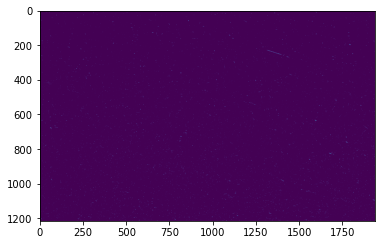

1121740.937 {'OTR': True, 'CTR': True, 'LDBP': 2, 'Plunger': None} 1 933


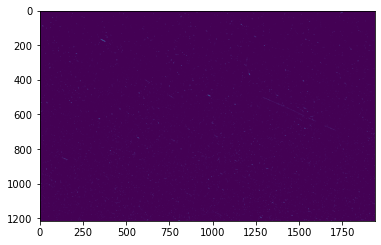

In [160]:
for i in np.arange(900,934,1):
    
    ex_data, protons, rif, laser, screens = load_all_event_data('2024/09/14',event_files[i],spectro_no=2,threshold=1750000)
    if rif == 1121740.937:
        print(rif, screens, laser, i)
        
        plt.imshow(ex_data,vmax=4095)
        plt.show()

In [14]:
test_14_09 = sort_by_space_scin_screen(680,1936,930,933,'2024/09/14',2)

In [15]:
fit_to_spectrometer_no_filter(test_14_09,3,'2024/09/14',2)

/tmp/ipykernel_457/1763292909.py:37: OptimizeWarning: Covariance of the parameters could not be estimated
  params = curve_fit(fit_line, x, y)[0]


'Your dataset has been saved'

In [27]:
data =  np.load(f"slope_intercept_data_2024-09-14_Spectro_2_Upto_Event_3_nofilter.npz")
print(data.files)

['RIF_1121740.937_Laser_0_Screens_Plunger9_slope', 'RIF_1121740.937_Laser_0_Screens_Plunger9_intercepts']


In [130]:
background_ex = background_subtraction_nofilter('2024/09/14',950, 2, threshold=1.75e6,stored_event=3)

NpzFile 'slope_intercept_data_2024-09-14_Spectro_2_Upto_Event_3_screens_None_nofilter.npz' with keys: RIF_1121740.937_Laser_1_Screens_None_slope, RIF_1121740.937_Laser_1_Screens_None_intercepts
Shapes - slopes: (1216, 1936) intercepts: (1216, 1936) data: (1216, 1936)
Protons: 27.719303


Text(0.5, 1.0, 'Background Subtracted Image, 14.09.24')

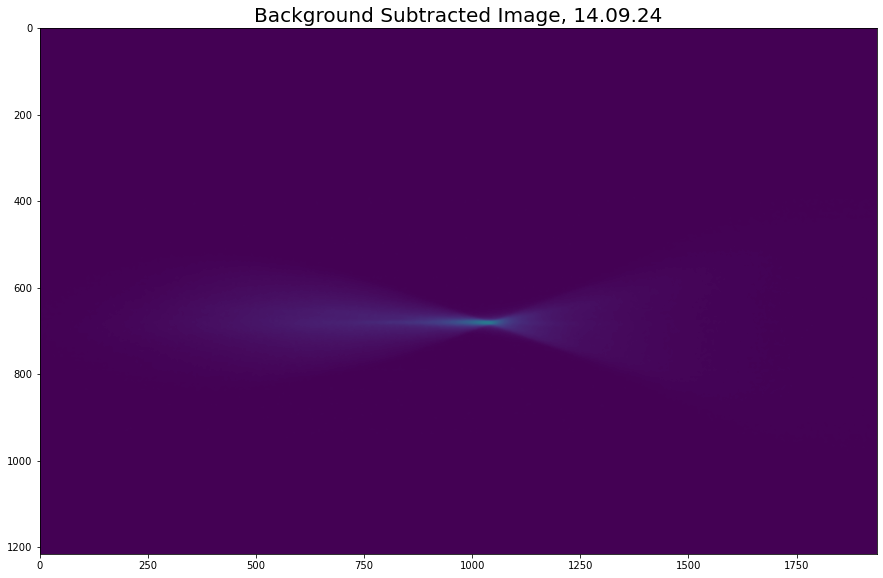

In [26]:
plt.figure(figsize=(15,10))
plt.imshow(background_ex,vmax=4095)
plt.title('Background Subtracted Image, 14.09.24',fontsize=20)

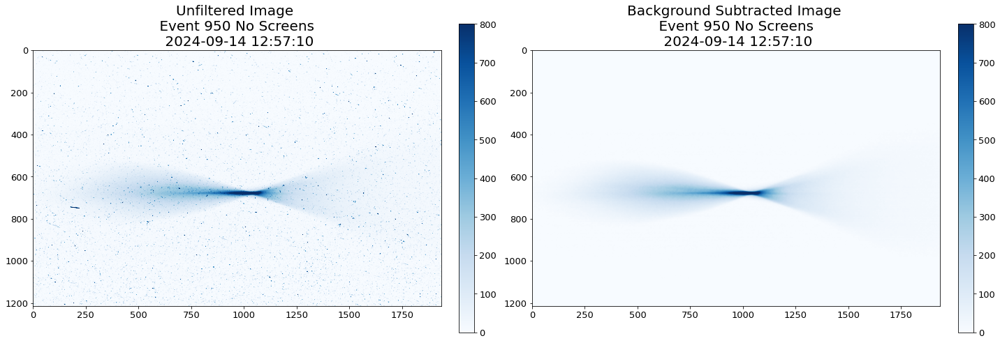

In [134]:
fig, axes = plt.subplots(1, 2, figsize=(20, 15))

selectedEvent = os.path.join(DATA_PATH, event_files[950])

stamp = int(selectedEvent[44:63])
timestamp = pd.to_datetime(stamp)
formatted_timestamp = timestamp.strftime('%Y-%m-%d %H:%M:%S')

# EVENT 963 
# First subplot
im1 = axes[0].imshow(ex_data, cmap='Blues', vmin=0, vmax=800)
axes[0].set_title(f'Unfiltered Image \n Event 950 No Screens \n {formatted_timestamp}', fontsize=20)
cbar1 = fig.colorbar(im1, ax=axes[0], fraction=0.035, pad=0.04)
cbar1.ax.tick_params(labelsize=13)


# Second subplot
im2 = axes[1].imshow(background_ex, cmap='Blues', vmin=0, vmax=800)
axes[1].set_title(f'Background Subtracted Image \n Event 950 No Screens \n {formatted_timestamp}', fontsize=20)
cbar = fig.colorbar(im2, ax=axes[1], fraction=0.035, pad=0.04)
cbar.ax.tick_params(labelsize=13)

axes[1].tick_params(axis='both', which='major', labelsize=13)
axes[0].tick_params(axis='both', which='major', labelsize=13)


plt.tight_layout()
plt.show()

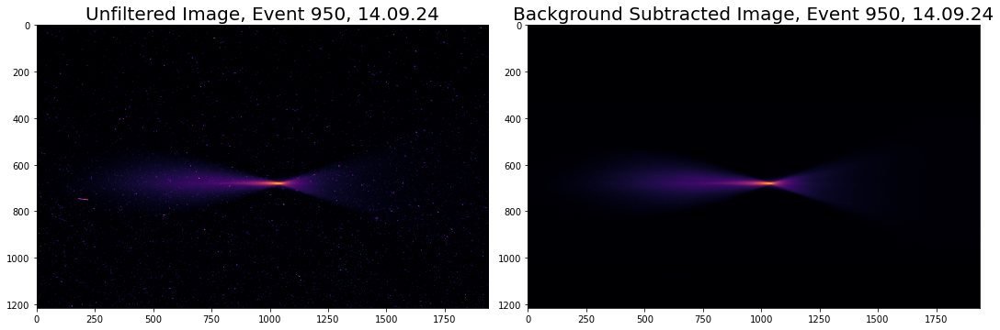

In [132]:
fig, axes = plt.subplots(1, 2, figsize=(15, 10))

## EVENT 950 
# First subplot
axes[0].imshow(ex_data,cmap='inferno', vmax=2000)
axes[0].set_title('Unfiltered Image, Event 950, 14.09.24', fontsize=20)

# Second subplot
axes[1].imshow(background_ex,cmap='inferno', vmax=2000)
axes[1].set_title('Background Subtracted Image, Event 950, 14.09.24', fontsize=20)

plt.tight_layout()
plt.show()

# CASE 2 - LBDP - No filter

In [22]:
def fit_to_spectrometer_no_filter(rif_data, no_events, Date, camera_number):
    saved_slopes_intercepts = {}
    list_rifs = list(rif_data)
    
    for rif in list_rifs:
        list_laser_values = list(rif_data[rif])
        
        for laser in list_laser_values:
            list_screen_combos = list(rif_data[rif][laser])

            for screen_label in list_screen_combos:
                data = rif_data[rif][laser][screen_label]
                index_count = list(data)

                slope_heat_map = np.zeros((1216, 1936))
                intercept_error_hm = np.zeros((1216, 1936))
                slope_int_error_hm = np.zeros((1216, 1936))
                
                slope_error_hm = np.zeros((1216, 1936))
                intercept_heat_map = np.zeros((1216, 1936))

                for i in index_count:
                    x = np.array(data[i]['proton_count'])  
                    y = np.array(data[i]['fit_parameters'])

                    if len(x) >= 3 and i != 'full_image':  # Curve fitting requires at least two data points
                        params,pcov = curve_fit(fit_line, x, y)
                        a, b = params
                        c, d = np.diag(pcov)
                        e = (pcov[0,1])

                        slope_heat_map[i[0]:i[1],i[2]:i[3]] = a 
                        intercept_heat_map[i[0]:i[1],i[2]:i[3]] = b
                        
                        slope_error_hm[i[0]:i[1],i[2]:i[3]] = c
                        intercept_error_hm[i[0]:i[1],i[2]:i[3]] = d
                        slope_int_error_hm[i[0]:i[1],i[2]:i[3]] = e


                ## write to dictionary
                key = f"RIF_{rif}_Laser_{laser}_Screens_{screen_label}"
                saved_slopes_intercepts[f"{key}_slope"] = slope_heat_map
                saved_slopes_intercepts[f"{key}_intercepts"] = intercept_heat_map
                saved_slopes_intercepts[f"{key}_slope_errors"] = slope_error_hm
                saved_slopes_intercepts[f"{key}_intercept_errors"] = intercept_error_hm
                saved_slopes_intercepts[f"{key}_slope_int_errors"] = slope_int_error_hm
                
    date_format = Date.replace('/','-')
    np.savez_compressed(f"slope_intercept_data_{date_format}_Spectro_{camera_number}_Upto_Event_{no_events}_screens_{screen_label}_nofilter.npz",**saved_slopes_intercepts)
    
    return 'Your dataset has been saved'

In [104]:
test_14_09_ldbp_full_Screen = sort_by_space_scin_screen(680,1936,1159,1163,'2024/09/14',2)

In [115]:
fit_to_spectrometer_no_filter(test_14_09_ldbp_full_Screen,4,'2024/09/14',2)

/tmp/ipykernel_513/3950915343.py:27: OptimizeWarning: Covariance of the parameters could not be estimated
  params,pcov = curve_fit(fit_line, x, y)


'Your dataset has been saved'

In [116]:
data =  np.load(f"slope_intercept_data_2024-09-14_Spectro_2_Upto_Event_4_screens_LDBP_nofilter.npz")
print(data.files)

['RIF_1121740.937_Laser_0_Screens_LDBP_slope', 'RIF_1121740.937_Laser_0_Screens_LDBP_intercepts', 'RIF_1121740.937_Laser_0_Screens_LDBP_slope_errors', 'RIF_1121740.937_Laser_0_Screens_LDBP_intercept_errors', 'RIF_1121740.937_Laser_0_Screens_LDBP_slope_int_errors']


In [12]:
def background_subtraction_nofilter(Date, event, camera_number, threshold, stored_event):
    
    ## load data
    event_files = os.listdir(f'/eos/experiment/awake/event_data/{Date}')
    data, protons, rif, laser, screens = load_all_event_data(Date,event_files[event],spectro_no=camera_number,threshold=1.3e6)
    
    ## remove electronic noise and median filter
    bg_sensor = np.array(data) - 3.78126279
    data_w_median_filter = ski.filters.median(bg_sensor, footprint=disk(4)) 
    
    screen_label = check_screens(screens)
    
    date_format = Date.replace('/','-')
    m_c_data = np.load(f"slope_intercept_data_{date_format}_Spectro_{camera_number}_Upto_Event_{stored_event}_screens_{screen_label}_nofilter.npz")
    print(m_c_data)
    slopes = m_c_data[f"RIF_{rif}_Laser_0_Screens_{screen_label}_slope"]
    intercepts = m_c_data[f"RIF_{rif}_Laser_0_Screens_{screen_label}_intercepts"]
    sigma_mm = m_c_data[f"RIF_{rif}_Laser_0_Screens_{screen_label}_slope_errors"]
    sigma_cc = m_c_data[f"RIF_{rif}_Laser_0_Screens_{screen_label}_intercept_errors"]
    sigma_mc = m_c_data[f"RIF_{rif}_Laser_0_Screens_{screen_label}_slope_int_errors"]
    
     
    background = slopes*protons + intercepts
    
    variance = (protons**2) * sigma_mm + 2 * protons * sigma_mc + sigma_cc
    pixel_uncertainty = np.sqrt(np.abs(variance))  
    pixel_uncertainty = np.nan_to_num(pixel_uncertainty, nan=0.0, posinf=0.0, neginf=0.0)
    
    print("Shapes - slopes:", slopes.shape, "intercepts:", intercepts.shape, "data:", data.shape)
    print("Protons:", protons)

    cleaned_image = data_w_median_filter - background
    
    return cleaned_image, pixel_uncertainty

In [ ]:
## with median filter applied to both data sets

In [14]:
background_ex_nofilter, uncertainty_ldbp = background_subtraction_nofilter('2024/09/14',963, 2, threshold=1.75e6,stored_event=4)

NpzFile 'slope_intercept_data_2024-09-14_Spectro_2_Upto_Event_4_screens_LDBP_nofilter.npz' with keys: RIF_1121740.937_Laser_0_Screens_LDBP_slope, RIF_1121740.937_Laser_0_Screens_LDBP_intercepts, RIF_1121740.937_Laser_0_Screens_LDBP_slope_errors, RIF_1121740.937_Laser_0_Screens_LDBP_intercept_errors, RIF_1121740.937_Laser_0_Screens_LDBP_slope_int_errors
Shapes - slopes: (1216, 1936) intercepts: (1216, 1936) data: (1216, 1936)
Protons: 29.135962


In [132]:
for i in uncertainty_ldbp.flatten():
    
    if i != 0:
        print(i)

0.6094146582940111
1.5031256112936477
0.9683223796894962
0.38054224443657636
0.6864594541652582
0.5279413362228965
0.08196956162006742
1.2075796395851592
1.503125623646812
0.45763959305831675
1.1998354765324908
1.1743889716603941
0.8101504832298777
1.2188282883736619
1.0268825783070552
1.0357125663002928
0.45763959305831675
1.5801487707699808
0.6864594579982339
1.6203012156566383
1.669553974464667
2.037263853134144
0.45763965004925095
2.267911415552727
1.6798325854191907
0.9835012927722394
1.6644115504741006
0.4914837849252306
2.4986064664317382
1.0459558263367772
1.6287530654307798
2.289923729719471
2.0919120329610204
2.0854689347210353
2.7650214661999524
1.490202149702996
1.556348531251677
1.531065542141159
1.0929170598294429
0.4372003647322363
1.0357124867178344
1.1242056522943946
2.039021126916563
2.8531440967497024
3.5111263437955538
2.542534671603996
1.8537855559198615
1.4327815090672258
1.4684360033551958
0.7183651710709112
0.7183666149421428
0.2288198169589794
2.062836619668430

6.042075778867462
7.384243326545518
5.476892081825711
4.72858099165051
2.7037343853696294
1.7748672271932622
2.963559181622837
5.26847479977239
3.1485522367986225
3.3690597303601573
3.665323577161547
6.177608538859313
6.0378979376728665
3.3012158439988712
3.678473019233595
4.223219153837331
4.160461060743117
3.2417784000389496
3.160297453457864
2.751492443175101
4.354526714945139
3.1943132796272735
2.7407960129677273
2.913512607730382
2.503370562361951
4.4159683987660925
4.630678526125261
6.483736668810283
5.457984885315339
4.603144127187418
5.932939319302216
6.246507975435831
3.9737203814783255
2.8104540737168677
0.9835012170728251
1.7001447131993035
3.383155216424176
3.6824496722019986
5.309670605605467
7.681192503377504
4.142683519831471
5.4482407087094575
5.8737426064800005
6.030737356320956
5.9267093266029445
3.0158786413325855
2.7901861800595307
4.92514229861602
3.224364906094177
2.0865435699454045
4.162989254444601
2.9711920481326013
0.6495327368883035
3.0652703845293163
8.04239

4.871822866562877
2.8278269420408595
1.7662551789074339
1.119005746719564
0.9810400100641055
2.5807195912304284
1.3892088882984754
3.301215068705517
3.295906928532133
7.096900778099324
5.460595383255609
4.584117227550092
5.879156362647205
6.1320976570494095
3.9997041433088554
1.058783562301825
3.1382789651650356
4.000570585322137
2.8176119010423233
2.247336307381106
7.064809155790649
7.927727463942411
5.3484759374888515
6.667200889578427
1.956901704204625
2.9983831376928465
4.934201882387649
2.0516123218632774
0.9049886184532469
2.6025134612302656
2.9954867750472856
5.9650024783208515
4.60500954701469
2.6250844611053403
6.26143789197648
7.939045036310316
4.920449062804583
1.932308586707007
3.6378432610783538
4.836468117190427
2.1077005409312903
1.2199536023859572
0.6859310348150223
1.9724975023292803
1.787453520064393
1.8343526939177848
4.169383588334432
6.323956524744237
3.416159227095432
6.570426533308918
7.110280543439015
9.365808913122649
3.2390616218830197
6.469792493840889
4.4097

5.393852347787273
3.689155274238889
3.0178512971654765
5.8699812659865245
5.543826950695321
3.045102006141717
4.5838570688510485
4.215175009836258
5.692465674579365
6.953935675789861
6.498222802678436
6.498222802678436
3.3672279039845083
4.2688255929870795
6.5259603191890685
4.645652776706898
4.8912136226457426
6.1419787456295
6.667235983272158
5.34847121547378
6.002234281079596
1.4716728883088745
2.366622582010991
1.7717734355301114
2.003175749643343
7.223027159577241
4.959747987865711
6.925370440196388
7.824100871113454
1.8275000880919452
4.896262766273519
4.53039072115864
4.002790433749755
6.9464716262062325
3.5114854603885037
4.390890909152345
4.0712750080299624
2.898011029101311
9.880527099108743
8.416989285009517
7.8511750865076175
2.7719339303472608
3.1738938272952373
4.040210736330303
4.315146106497535
2.0499893842305363
3.7147138853935346
5.151784189302966
5.659855954789403
6.18832809488728
4.601223101729822
7.621845042510773
6.898653411202113
1.8376186682505053
3.477576125652

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



5.921685162952698
6.59121407309423
10.173925034129606
7.345026803519614
5.54256294762406
2.317214430771755
3.7269355209736426
3.07092243534802
3.540601538860578
5.138324036394453
4.578303095275504
5.420521558096266
4.061538786040654
2.9968621850855888
3.8313224786639823
3.5497337228323764
3.5497337228323764
0.9835484359188172
2.085146146522868
3.7808493040290916
2.807693251543397
3.527191184835712
3.886701860048745
3.771990751887646
1.6540359661568265
1.1903692744966978
1.751502656203132
5.510372098535172
6.903344905045605
7.008926077719297
9.54035104414227
8.789969286902334
9.260572895992242
8.784482762930725
9.122013374515184
4.520598410772403
7.363515092789712
3.6873627076724964
4.8396119409114355
6.825752325287111
6.4624963552593115
6.505089688036641
6.257763413991488
5.30332177161236
5.687994552475192
7.426910304083929
8.95640307398081
10.12692298362164
7.820694247304364
5.363154865630187
2.85966796352558
8.551498822731395
8.013381218888165
7.579957519816466
9.174363484501315
9.23

4.91344205938144
4.006960799623406
4.4002425614923855
4.031619792241769
1.1496539134058363
0.8293624086769704
3.6798004868899308
4.5151565892701715
6.323378546058014
7.475290814774945
10.13512374923991
7.552120914506009
4.4588634242957355
5.282063438271143
8.10521203556601
5.641472232258906
6.042852443726199
8.884292792719974
9.920618345387712
9.865950951284173
8.201043558435433
5.644110350135991
4.3209828669698345
2.3115511589831135
1.885389525736105
1.294078620349153
3.2321535829583348
4.188142786036564
4.392424696651647
4.438986461147187
3.033801958291308
3.064192930184682
2.364425396796338
2.364425396796338
3.103441521781697
0.876098657378079
2.2532118886921815
5.029507839155942
4.498348868910313
4.058334680816346
2.0193172247352327
7.017242527270617
6.195552352164361
8.532237250345416
8.686706347385288
10.61965690091241
10.73199877949897
12.392412402643588
12.063507380125627
12.643655842336194
9.983473446761012
8.94576691868811
10.481333915530334
9.402771354047193
2.68702155017733

4.4822254739837835
2.526926250308422
3.9506605638582517
3.9506605638582517
3.9506605638582517
11.608770847996746
8.897546830982789
6.749297224596147
6.276347261759431
9.329948049075718
2.627759839450823
2.0703933145866475
1.9838906979405602
4.899362423555782
4.869150650543548
4.7114488391214
6.706487672852204
8.316809050240035
5.68339398591645
8.252516765345817
5.4350833586003455
8.514802094730737
13.07319793804404
11.212840742469059
10.405333511878181
10.474446043040988
8.406809110041689
6.320480637201295
4.078044546204733
2.0031747272637364
3.5318057939534286
5.537143521382255
7.788237167437857
6.7971892793702695
7.574459885861804
3.384156114939664
3.9022189450710467
4.044928876988133
3.1382816770452555
4.285245847881644
3.0124707292099284
0.9277347551262158
1.2752698931945536
2.9490229123851184
2.21654630787494
1.3999115532509923
4.380068865652723
3.944150033758858
5.551680404654534
6.4007482115853325
6.736253372621992
5.3994828503803065
3.577782839780961
2.1639604014584735
2.091907

7.398837404237732
3.3531664954958074
5.059312371804546
5.278532597438678
4.794524609184174
5.02910619886887
5.094432978851526
3.3527406152893056
6.920857988960595
6.415089646588008
2.56402274922029
4.572990481901686
2.403889643633694
6.446937446815509
7.506575377122276
8.532365488190708
8.79548880292487
10.04170908560425
3.924913668972031
6.519176886388541
4.279398059001465
2.3524915400425734
0.8121175661569324
3.114468356228897
3.332475762757133
1.8063151945303009
8.055965398638705
9.29956575690997
2.915992092940125
3.150001955052978
3.4871580217364158
1.1057769300399667
2.042760931144178
1.138466425017273
3.836363688360559
5.108369915042587
4.0986152364507085
3.5545778094294067
6.1293268949740165
6.3044377379579055
3.6098917876294694
3.0142488967076293
0.9549885852017596
2.757779758708229
0.8822760572151525
2.2389840304250965
0.7314649643071447
3.97306991688763
3.7131542455736852
3.372664151188846
1.8812345573326907
0.4433177361515944
3.611693911673786
1.7772406066700823
2.1931017397

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



4.123769311797347
4.245928357159531
6.3045520602357765
7.240379171810977
5.492842937917781
8.693871361005623
5.687998945409385
6.006133568954886
4.156083617655047
3.3998585684741562
3.3982589418886477
1.9726342375029993
3.74031883683035
3.74031883683035
2.944136152311205
3.740319774462925
2.358630601431269
2.15780854847245
2.507066290260949
2.5505403168749416
6.684535587839851
4.1189153827569305
4.379606231829752
5.231677947036685
5.768484294504841
5.860613048118159
7.077730766488676
8.277440845285668
5.9935656604002565
7.12333192372085
6.003835663486466
7.494163975950941
7.955845922334106
9.675895058724524
4.344341037520525
6.485989244315586
3.698657939329055
3.698657939329055
2.437645815325514
5.110012098804437
1.6548693972821755
4.772466047548268
4.389491265151998
5.408383120988127
3.6100252097566625
3.216609864139905
5.329226449539957
2.5444304205517683
2.208705803335312
0.39144205871418253
1.807421873345223
2.6457257741221487
2.216547913968901
2.925421474939223
2.481587540271764
3

2.209754642274211
6.782617049176045
6.227005680673602
9.370761043250953
5.867768303697384
4.101949287493097
2.9590251948224062
2.9590251948224062
4.089500189266409
2.4804008701812195
7.728220612393368
7.499496848011617
7.076825617070071
4.902186921022316
7.24649796963379
4.59774499313396
5.3935593395790375
4.815298449348802
3.6776245833097647
3.6467347409114774
2.692321957764643
3.757775256938095
4.703081195436878
2.0851421505679086
1.7067853286052115
3.717221727348038
4.944117616971051
6.861763909098978
7.496224500398268
5.397636810395713
4.754675589572295
3.0002909313303605
3.596960345883393
2.2068621317095447
4.686464720221974
3.8479133819834725
5.818864001622671
4.790739438210944
14.842045842200847
5.387555558387327
7.637822557981719
7.242480074453466
2.761755162484342
4.1472295710789435
3.4322966102590766
2.0803559812602788
3.3724459311852817
8.291228216990248
5.647563429263169
0.9375927189037181
3.4649663816330545
3.068214114845759
0.9835479405527799
5.353769325324467
3.675240463

5.693669971563774
8.585921212347381
7.792422638458429
6.814218085018748
6.745663599863445
6.799251681293483
7.238414447701651
6.130539278303219
2.84062080768403
3.1144700384865183
2.4198184423923026
1.766255441084907
2.514858825398038
2.5444324936867644
2.7049696261053193
0.5414122414056702
3.1914312729878938
4.589618155043816
4.2255942595478695
3.318330398932356
3.5026239962084356
4.878092000739356
3.67122753088378
4.079281270866334
6.3411285877574475
4.955340818303148
5.380539216224578
3.5299590508308496
0.07267851912087543
2.5836659321481186
2.940748125551402
2.7710242242086154
4.768540410413608
3.5850284678237974
4.380011920357185
7.966769613674634
7.818991738302429
9.921781938307168
5.066547689288667
3.771809872579151
6.58115026914613
0.27335807858596334
3.7498288819037353
4.995931754283113
7.341528577988071
9.490630052404908
9.90399413332658
3.069616022856786
2.313264512761011
1.9776411059120376
2.0191794453001077
2.4184095248646935
3.049623386037269
3.464967527984496
3.049623386

2.619453239675693
7.43699898056886
12.495282750219975
12.42099271486654
14.681014221989127
12.302527796742579
13.354903911993631
8.657886349990838
7.9953483566918795
8.5180352255678
4.729465402432776
3.068253067147641
2.8360740200534167
6.1464573974275
5.818864833669974
10.959250719368388
7.227513284998628
5.288604627592649
8.809994248067214
10.52283698741088
9.188311069284365
7.707483416845407
8.17037679021802
12.92888955387046
8.145476523710164
8.402358460462942
10.950789120336978
12.749588209431863
8.58268348153129
8.525449885334433
13.311585599177347
15.134802777744714
15.547403631380055
14.183381714286359
17.92752569628166
16.179275403068974
15.579719527612625
14.013041931061636
14.248300059827288
12.026742933993237
9.336126453648633
6.268271412698972
9.811087963907946
7.925827406590161
7.0929564103439136
9.589486155151995
8.13656045563694
9.9087041916488
10.642582993129832
10.724311226534763
7.487990618088
4.725019787641002
3.3947809417691697
4.699805791623386
2.9056739280561277


IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



In [135]:
np.max(uncertainty_ldbp)

835661438837929.4

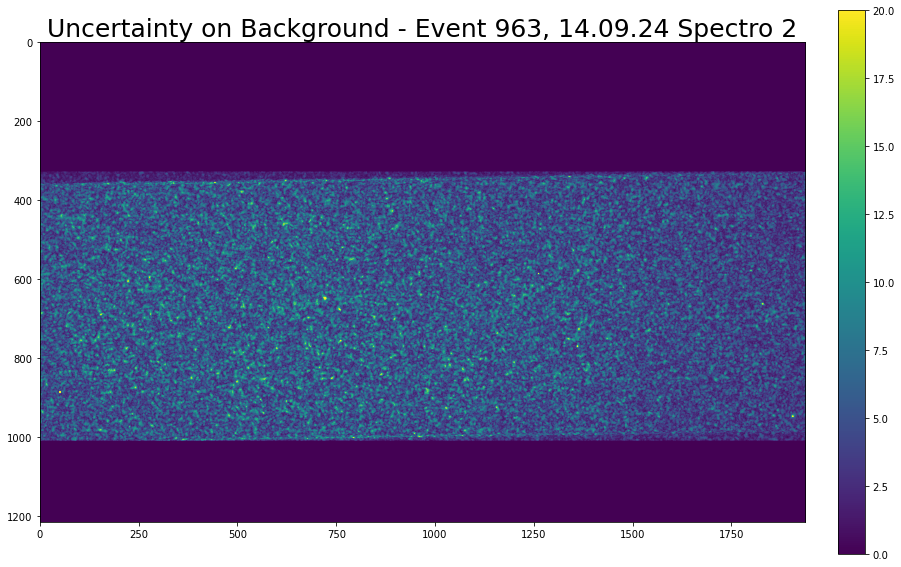

In [15]:
plt.figure(figsize=(15,10))

plt.title('Uncertainty on Background - Event 963, 14.09.24 Spectro 2',fontsize=25)
im = plt.imshow(uncertainty_ldbp, vmax=20)

plt.colorbar(im, fraction=0.046, pad=0.04)  
plt.show()

In [141]:
N = uncertainty_ldbp.size
np.sqrt(np.sum(uncertainty_ldbp**2)) / N

354969823.34282964

In [11]:
ex_data_lbdp, protons, rif, laser, screens = load_all_event_data('2024/09/14',event_files[963],spectro_no=2,threshold=1750000)

In [32]:
event_files[963]

'1726318911735000000_Type0_2064_2.h5'

In [41]:
Date = '2024/09/14'
DATA_PATH = f'/eos/experiment/awake/event_data/{Date}'
event_files = os.listdir(DATA_PATH)

selectedEvent = os.path.join(DATA_PATH, event_files[963])


with h5py.File(selectedEvent, 'r') as selectedEventFile:
    eventImg = selectedEventFile['AwakeEventData'][f'TCC4.SPECTRO2.DigiCam']['ExtractionImage']['image2D'][:]

In [18]:
import pandas as pd
import datetime
from datetime import datetime

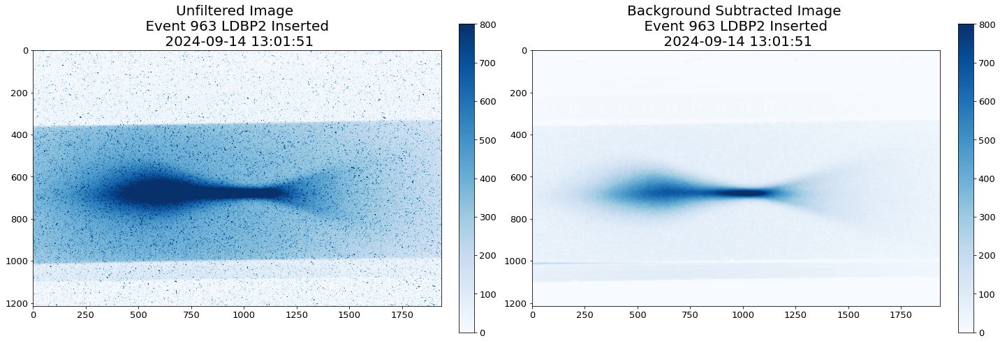

In [68]:
fig, axes = plt.subplots(1, 2, figsize=(20, 15))

stamp = int(selectedEvent[44:63])
timestamp = pd.to_datetime(stamp)
formatted_timestamp = timestamp.strftime('%Y-%m-%d %H:%M:%S')

# EVENT 963 
# First subplot
im1 = axes[0].imshow(ex_data_lbdp, cmap='Blues', vmin=0, vmax=800)
axes[0].set_title(f'Unfiltered Image \n Event 963 LDBP2 Inserted \n {formatted_timestamp}', fontsize=20)
cbar1 = fig.colorbar(im1, ax=axes[0], fraction=0.035, pad=0.04)
cbar1.ax.tick_params(labelsize=13)


# Second subplot
im2 = axes[1].imshow(background_ex_nofilter, cmap='Blues', vmin=0, vmax=800)
axes[1].set_title(f'Background Subtracted Image \n Event 963 LDBP2 Inserted \n {formatted_timestamp}', fontsize=20)
cbar = fig.colorbar(im2, ax=axes[1], fraction=0.035, pad=0.04)
cbar.ax.tick_params(labelsize=13)

axes[1].tick_params(axis='both', which='major', labelsize=13)
axes[0].tick_params(axis='both', which='major', labelsize=13)


plt.tight_layout()
plt.show()

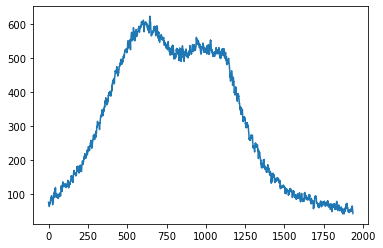

In [26]:
plt.plot(background_ex_nofilter[700,:])

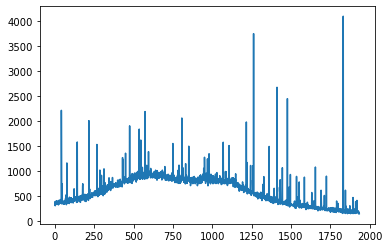

In [27]:
plt.plot(ex_data_lbdp[700,:])

Text(0.5, 1.0, 'Background Subtracted Image, Event 1063, 14.09.24')

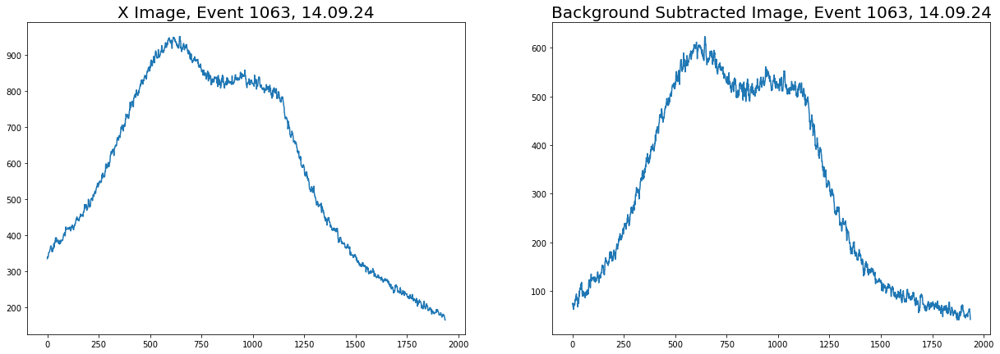

In [37]:
fig, axes = plt.subplots(1, 2, figsize=(21, 7))

mean_raw = np.mean(ex_data_lbdp,0)
N = ex_data_lbdp.shape[0]
std_raw = np.std(ex_data_lbdp,0)/(np.sqrt(N))

std_bg = np.std(background_ex_nofilter,0)/(np.sqrt(N))
mean_bg = np.mean(background_ex_nofilter,0)

x = np.arange(ex_data_lbdp.shape[1])

data_w_median_filter = ski.filters.median(ex_data_lbdp, footprint=disk(4)) 


## EVENT 963 
# First subplot
axes[0].plot(x,data_w_median_filter[700,:])
axes[0].set_title('X Image, Event 1063, 14.09.24', fontsize=20)
#axes[0].fill_between(x, mean_raw - std_raw, mean_raw + std_raw, alpha=0.3, label='Standard Error',color='blue')
#axes[0].legend()

axes[1].plot(x,background_ex_nofilter[700,:])
axes[1].set_title('Background Subtracted Image, Event 1063, 14.09.24', fontsize=20)
#axes[1].fill_between(x, mean_bg - std_bg, mean_bg + std_bg, alpha=0.3, label='Standard Error', color='blue')
#axes[1].legend()

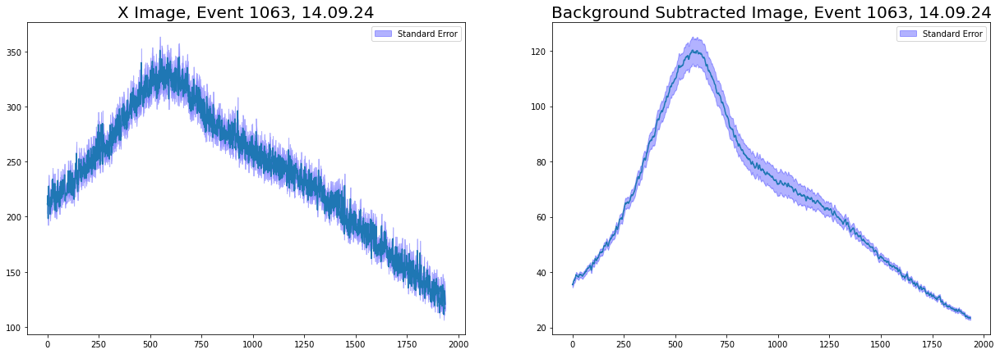

In [31]:
fig, axes = plt.subplots(1, 2, figsize=(21, 7))

mean_raw = np.mean(ex_data_lbdp,0)
N = ex_data_lbdp.shape[0]
std_raw = np.std(ex_data_lbdp,0)/(np.sqrt(N))

std_bg = np.std(background_ex_nofilter,0)/(np.sqrt(N))
mean_bg = np.mean(background_ex_nofilter,0)

x = np.arange(ex_data_lbdp.shape[1])

## EVENT 963 
# First subplot
axes[0].plot(x,mean_raw)
axes[0].set_title('X Image, Event 1063, 14.09.24', fontsize=20)
axes[0].fill_between(x, mean_raw - std_raw, mean_raw + std_raw, alpha=0.3, label='Standard Error',color='blue')
axes[0].legend()

axes[1].plot(x,mean_bg)
axes[1].set_title('Background Subtracted Image, Event 1063, 14.09.24', fontsize=20)
axes[1].fill_between(x, mean_bg - std_bg, mean_bg + std_bg, alpha=0.3, label='Standard Error', color='blue')
axes[1].legend()

Text(0.5, 1.0, 'Background Subtracted Image, Event 1063, 14.09.24')

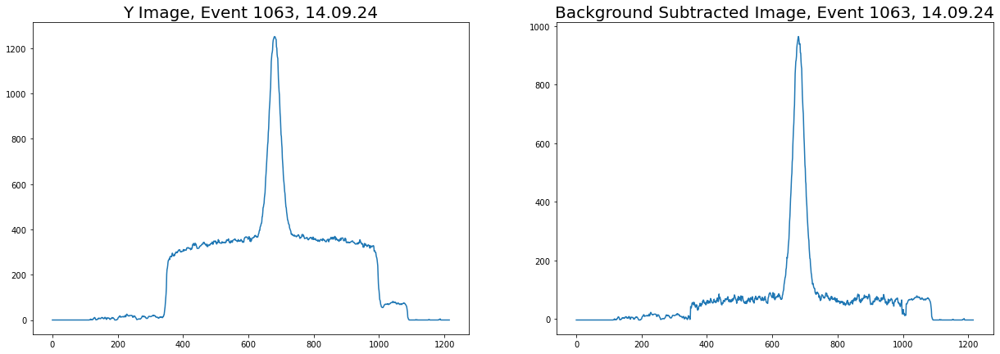

In [38]:
fig, axes = plt.subplots(1, 2, figsize=(21, 7))



x = np.arange(ex_data_lbdp.shape[0])
data_w_median_filter = ski.filters.median(ex_data_lbdp, footprint=disk(4)) 


## EVENT 963 
# First subplot
axes[0].plot(x,data_w_median_filter[:,1000])
axes[0].set_title('Y Image, Event 1063, 14.09.24', fontsize=20)

axes[1].plot(x,background_ex_nofilter[:,1000])
axes[1].set_title('Background Subtracted Image, Event 1063, 14.09.24', fontsize=20)

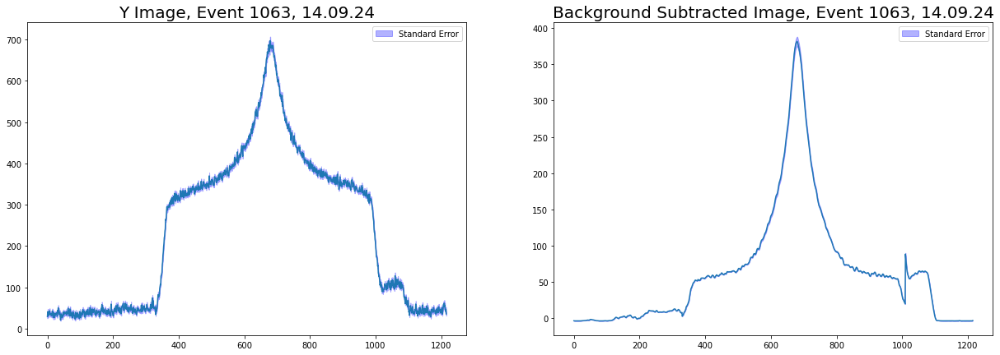

In [98]:
fig, axes = plt.subplots(1, 2, figsize=(21, 7))

mean_raw = np.mean(ex_data_lbdp,1)
N = ex_data_plunger.shape[1]
std_raw = np.std(ex_data_lbdp,1)/(np.sqrt(N))

std_bg = np.std(background_ex_nofilter,1)/(np.sqrt(N))
mean_bg = np.mean(background_ex_nofilter,1)

x = np.arange(ex_data_plunger.shape[0])

## EVENT 963 
# First subplot
axes[0].plot(x,mean_raw)
axes[0].set_title('Y Image, Event 1063, 14.09.24', fontsize=20)
axes[0].fill_between(x, mean_raw - std_raw, mean_raw + std_raw, alpha=0.3, label='Standard Error',color='blue')
axes[0].legend()

axes[1].plot(x,mean_bg)
axes[1].set_title('Background Subtracted Image, Event 1063, 14.09.24', fontsize=20)
axes[1].fill_between(x, mean_bg - std_bg, mean_bg + std_bg, alpha=0.3, label='Standard Error', color='blue')
axes[1].legend()

Shapes - slopes: (1216, 1936) intercepts: (1216, 1936) data: (1216, 1936)
Protons: 29.135962
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]


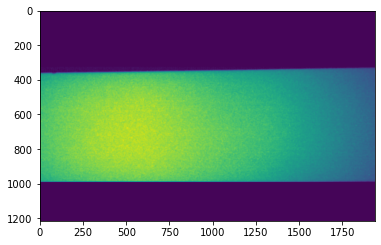

In [73]:
plot_fit_lines('2024/09/14',963, 2, threshold=1.75e6)

# CASE 3 - Plungers in

In [74]:
## RUN 2077

In [83]:
event_files[1183]

'1726327594935000000_Type0_2077_1.h5'

{'OTR': True, 'CTR': True, 'LDBP': 2, 'Plunger': 10} 1121740.937


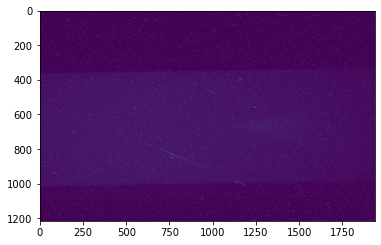

In [70]:
ex_data_plunger, protons, rif, laser, screens = load_all_event_data('2024/09/14',event_files[1190],spectro_no=2,threshold=1750000)
print(screens,rif)

plt.imshow(ex_data_plunger,vmax=4095)

1121740.937 {'OTR': True, 'CTR': True, 'LDBP': 3, 'Plunger': 10} 0 982


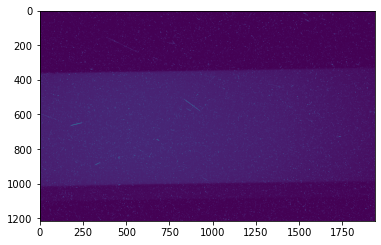

1121740.937 {'OTR': True, 'CTR': True, 'LDBP': 3, 'Plunger': 10} 0 983


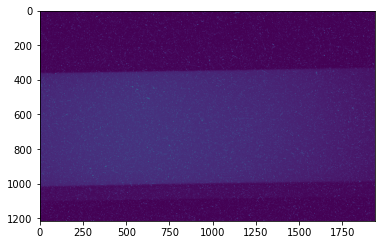

1121740.937 {'OTR': True, 'CTR': True, 'LDBP': 3, 'Plunger': 10} 0 984


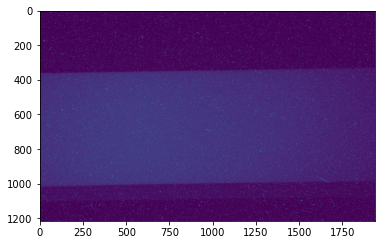

1121740.937 {'OTR': True, 'CTR': True, 'LDBP': 3, 'Plunger': 10} 0 985


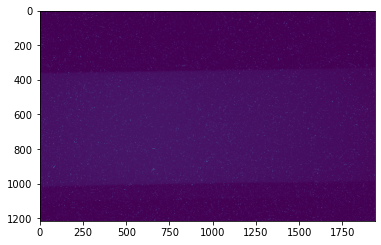

1121740.937 {'OTR': True, 'CTR': True, 'LDBP': 3, 'Plunger': 10} 0 986


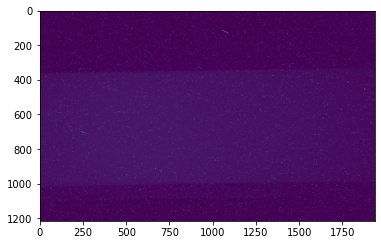

1121740.937 {'OTR': True, 'CTR': True, 'LDBP': 2, 'Plunger': 10} 0 987


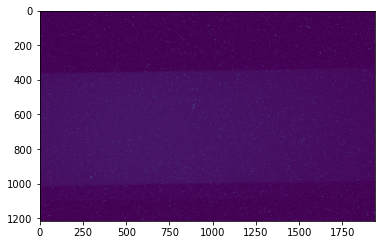

1121740.937 {'OTR': True, 'CTR': True, 'LDBP': 2, 'Plunger': 10} 0 988


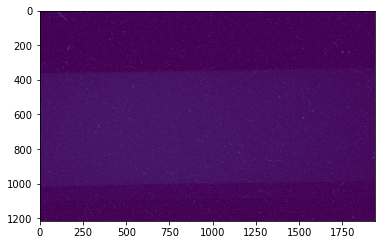

1121740.937 {'OTR': True, 'CTR': True, 'LDBP': 2, 'Plunger': 10} 1 989


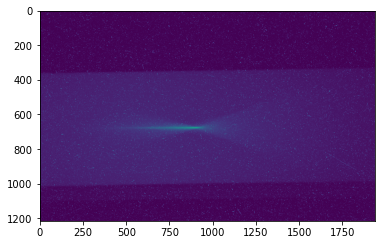

1121740.937 {'OTR': True, 'CTR': True, 'LDBP': 2, 'Plunger': 10} 1 990


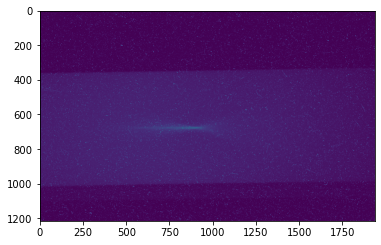

1121740.937 {'OTR': True, 'CTR': True, 'LDBP': 2, 'Plunger': 10} 1 991


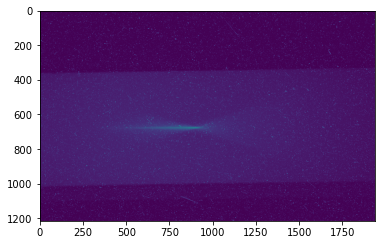

1121740.937 {'OTR': True, 'CTR': True, 'LDBP': 2, 'Plunger': 10} 1 992


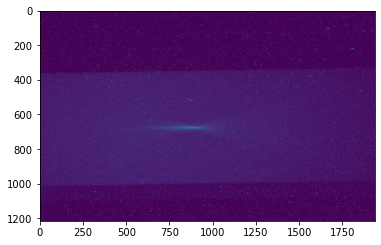

1121740.937 {'OTR': True, 'CTR': True, 'LDBP': 2, 'Plunger': 10} 1 993


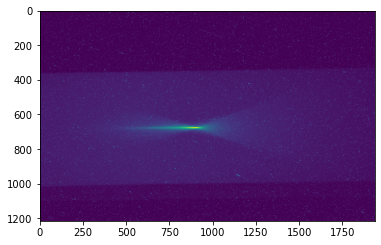

1121740.937 {'OTR': True, 'CTR': True, 'LDBP': 2, 'Plunger': 10} 1 994


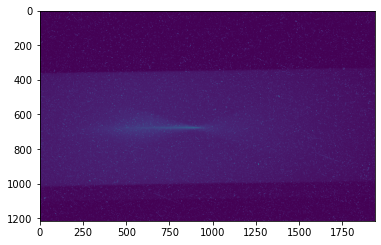

1121740.937 {'OTR': True, 'CTR': True, 'LDBP': 2, 'Plunger': 10} 1 995


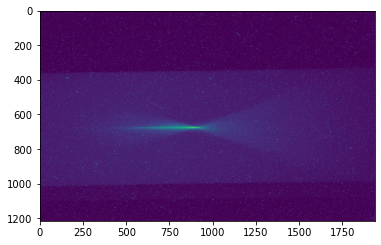

1121740.937 {'OTR': True, 'CTR': True, 'LDBP': 2, 'Plunger': 10} 1 996


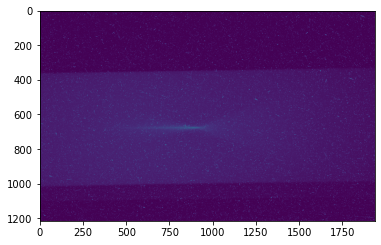

1121740.937 {'OTR': True, 'CTR': True, 'LDBP': 2, 'Plunger': 10} 1 997


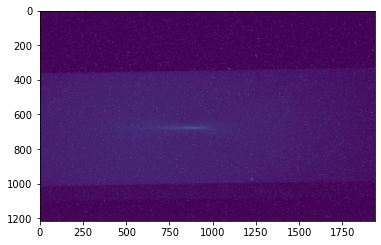

1121740.937 {'OTR': True, 'CTR': True, 'LDBP': 2, 'Plunger': 10} 1 998


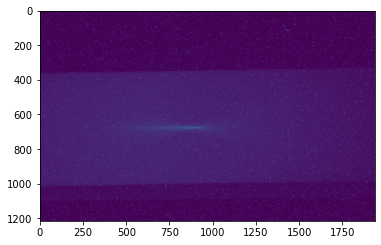

1121740.937 {'OTR': True, 'CTR': True, 'LDBP': 3, 'Plunger': 10} 0 1182


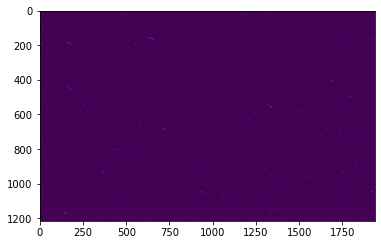

1121740.937 {'OTR': True, 'CTR': True, 'LDBP': 3, 'Plunger': 10} 0 1183


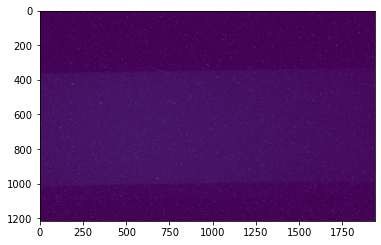

1121740.937 {'OTR': True, 'CTR': True, 'LDBP': 2, 'Plunger': 10} 0 1184


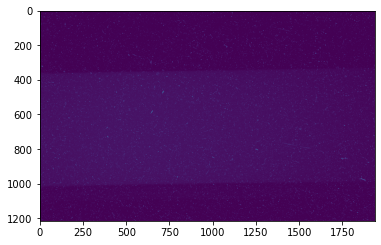

1121740.937 {'OTR': True, 'CTR': True, 'LDBP': 2, 'Plunger': 10} 1 1185


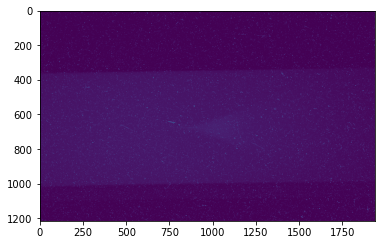

1121740.937 {'OTR': True, 'CTR': True, 'LDBP': 2, 'Plunger': 10} 1 1186


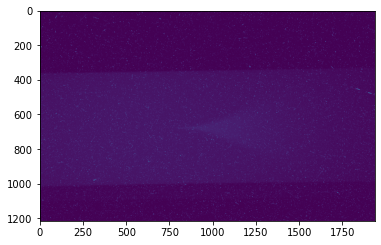

1121740.937 {'OTR': True, 'CTR': True, 'LDBP': 2, 'Plunger': 10} 1 1187


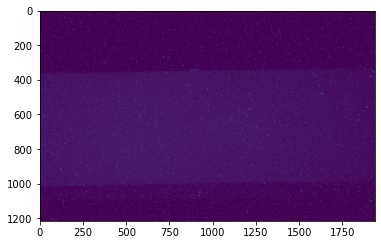

1121740.937 {'OTR': True, 'CTR': True, 'LDBP': 2, 'Plunger': 10} 1 1188


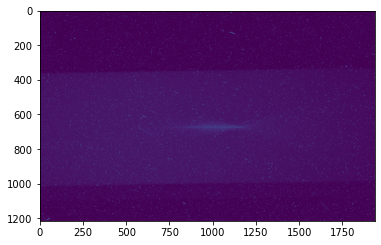

1121740.937 {'OTR': True, 'CTR': True, 'LDBP': 2, 'Plunger': 10} 1 1189


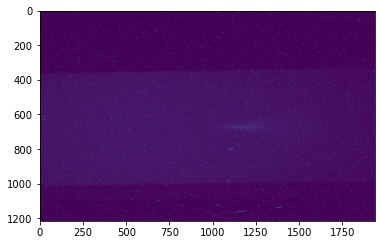

1121740.937 {'OTR': True, 'CTR': True, 'LDBP': 2, 'Plunger': 10} 1 1190


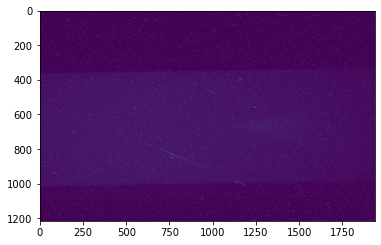

1121740.937 {'OTR': True, 'CTR': True, 'LDBP': 2, 'Plunger': 10} 1 1191


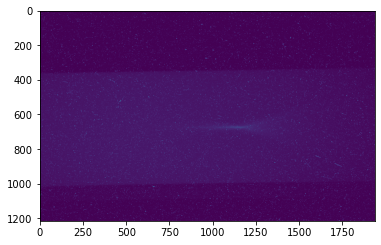

1121740.937 {'OTR': True, 'CTR': True, 'LDBP': 2, 'Plunger': 10} 1 1192


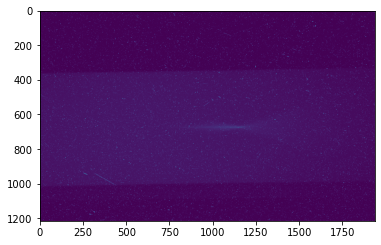

1121740.937 {'OTR': True, 'CTR': True, 'LDBP': 2, 'Plunger': 10} 1 1193


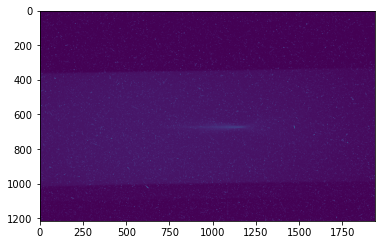

1121740.937 {'OTR': True, 'CTR': True, 'LDBP': 2, 'Plunger': 10} 1 1194


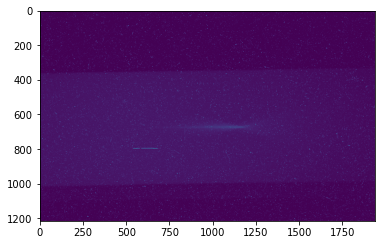

1121740.937 {'OTR': True, 'CTR': True, 'LDBP': 2, 'Plunger': 10} 0 1195


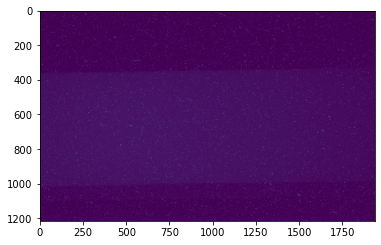

In [100]:
for i in np.arange(0,len(event_files),1):
    
    ex_data, protons, rif, laser, screens = load_all_event_data('2024/09/14',event_files[i],spectro_no=2,threshold=1750000)
    
    if screens['LDBP'] != 0 and screens['Plunger'] == 10 and rif == 1121740.937:
        print(rif, screens, laser, i)
        
        plt.imshow(ex_data,vmax=4095)
        plt.show()

In [123]:
### 985 to 988 - again laser == 0 

In [20]:
test_14_09_p10 = sort_by_space_scin_screen(680,1936,985,988,'2024/09/14',2)

In [23]:
fit_to_spectrometer_no_filter(test_14_09_p10, 3,'2024/09/14',2)

/tmp/ipykernel_591/3950915343.py:27: OptimizeWarning: Covariance of the parameters could not be estimated
  params,pcov = curve_fit(fit_line, x, y)


'Your dataset has been saved'

In [ ]:
data =  np.load(f"slope_intercept_data_2024-09-14_Spectro_2_Upto_Event_4_nofilter.npz")
print(data.files)

In [16]:
background_ex_nofilter_p10, uncertainty_p10 = background_subtraction_nofilter('2024/09/14',1193, 2, threshold=1.75e6, stored_event = 3)

NpzFile 'slope_intercept_data_2024-09-14_Spectro_2_Upto_Event_3_screens_Plunger10_nofilter.npz' with keys: RIF_1121740.937_Laser_0_Screens_Plunger10_slope, RIF_1121740.937_Laser_0_Screens_Plunger10_intercepts, RIF_1121740.937_Laser_0_Screens_Plunger10_slope_errors, RIF_1121740.937_Laser_0_Screens_Plunger10_intercept_errors, RIF_1121740.937_Laser_0_Screens_Plunger10_slope_int_errors
Shapes - slopes: (1216, 1936) intercepts: (1216, 1936) data: (1216, 1936)
Protons: 28.235882


In [71]:
ex_data_plunger19, protons, rif, laser, screens = load_all_event_data('2024/09/14',event_files[1193],spectro_no=2,threshold=1750000)

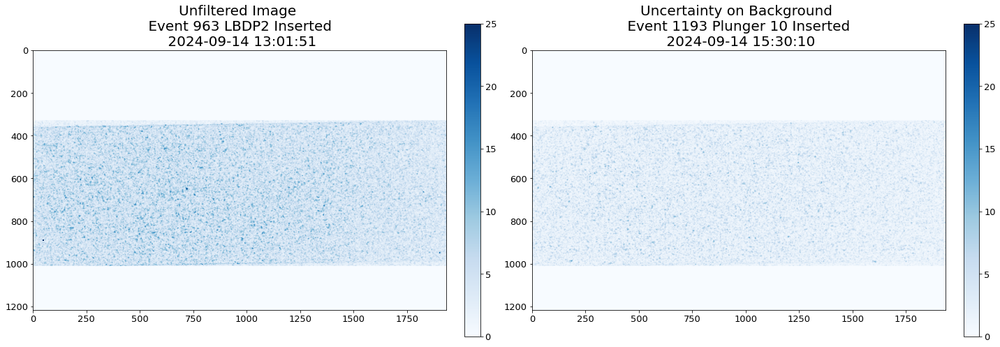

<Figure size 432x288 with 0 Axes>

In [20]:
fig, axes = plt.subplots(1, 2, figsize=(20, 15))

selectedEvent1 = os.path.join(DATA_PATH, event_files[963])
stamp1 = int(selectedEvent1[44:63])
timestamp1 = pd.to_datetime(stamp1)
formatted_timestamp1 = timestamp1.strftime('%Y-%m-%d %H:%M:%S')

selectedEvent = os.path.join(DATA_PATH, event_files[1193])
stamp = int(selectedEvent[44:63])
timestamp = pd.to_datetime(stamp)
formatted_timestamp = timestamp.strftime('%Y-%m-%d %H:%M:%S')


# EVENT 963 
# First subplot
im1 = axes[0].imshow(uncertainty_ldbp, cmap='Blues', vmin=0,vmax=20)
axes[0].set_title(f'Unfiltered Image \n Event 963 LBDP2 Inserted \n {formatted_timestamp1}', fontsize=20)
cbar1 = fig.colorbar(im1, ax=axes[0], fraction=0.035, pad=0.04)
cbar1.ax.tick_params(labelsize=13)


# Second subplot
im2 = axes[1].imshow(uncertainty_p10, cmap='ind', vmin=0, vmax=20)
axes[1].set_title(f'Uncertainty on Background \n Event 1193 Plunger 10 Inserted \n {formatted_timestamp}', fontsize=20)
cbar = fig.colorbar(im2, ax=axes[1], fraction=0.035, pad=0.04)
cbar.ax.tick_params(labelsize=13)

axes[1].tick_params(axis='both', which='major', labelsize=13)
axes[0].tick_params(axis='both', which='major', labelsize=13)


plt.tight_layout()
plt.show()
plt.colorbar(im, fraction=0.046, pad=0.04)  # Adjust `fraction` and `pad` for size and spacing
plt.show()

In [44]:
event_files[1193]

'1726327810935000000_Type0_2077_11.h5'

In [48]:
%matplotlib notebook

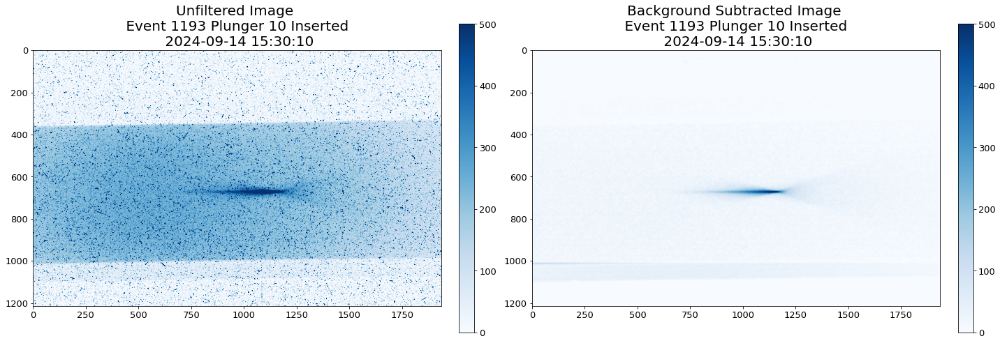

In [96]:
fig, axes = plt.subplots(1, 2, figsize=(20, 15))

selectedEvent = os.path.join(DATA_PATH, event_files[1193])
stamp = int(selectedEvent[44:63])
timestamp = pd.to_datetime(stamp)
formatted_timestamp = timestamp.strftime('%Y-%m-%d %H:%M:%S')

# EVENT 963 
# First subplot
im1 = axes[0].imshow(ex_data_plunger19, cmap='Blues', vmin=0,vmax=500)
axes[0].set_title(f'Unfiltered Image \n Event 1193 Plunger 10 Inserted \n {formatted_timestamp}', fontsize=20)
cbar1 = fig.colorbar(im1, ax=axes[0], fraction=0.035, pad=0.04)
cbar1.ax.tick_params(labelsize=13)


# Second subplot
im2 = axes[1].imshow(background_ex_nofilter_p10, cmap='Blues', vmin=0, vmax=500)
axes[1].set_title(f'Background Subtracted Image \n Event 1193 Plunger 10 Inserted \n {formatted_timestamp}', fontsize=20)
cbar = fig.colorbar(im2, ax=axes[1], fraction=0.035, pad=0.04)
cbar.ax.tick_params(labelsize=13)

axes[1].tick_params(axis='both', which='major', labelsize=13)
axes[0].tick_params(axis='both', which='major', labelsize=13)


plt.tight_layout()
plt.show()

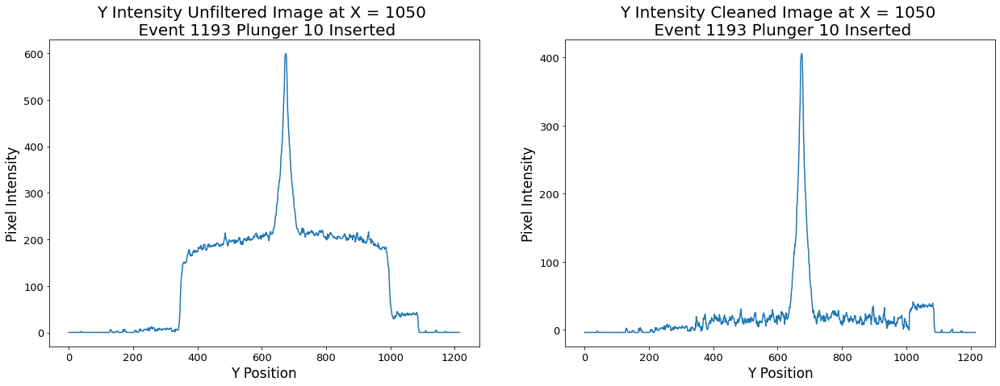

In [139]:
fig, axes = plt.subplots(1, 2, figsize=(21, 7))

x = np.arange(ex_data_plunger19.shape[0])
data_w_median_filter = ski.filters.median(ex_data_plunger19, footprint=disk(4)) 


## EVENT 963 
# First subplot
axes[0].plot(x,data_w_median_filter[:,1050])
axes[0].set_title(f'Y Intensity Unfiltered Image at X = 1050 \n Event 1193 Plunger 10 Inserted', fontsize=20)
axes[0].set_ylabel('Pixel Intensity',fontsize=17)
axes[0].set_xlabel('Y Position',fontsize=17)

axes[1].plot(x,background_ex_nofilter_p10[:,1050])
axes[1].set_title(f'Y Intensity Cleaned Image at X = 1050 \n Event 1193 Plunger 10 Inserted', fontsize=20)
axes[1].set_ylabel('Pixel Intensity',fontsize=17)
axes[1].set_xlabel('Y Position',fontsize=17)

axes[1].tick_params(axis='both', which='major', labelsize=13)
axes[0].tick_params(axis='both', which='major', labelsize=13)

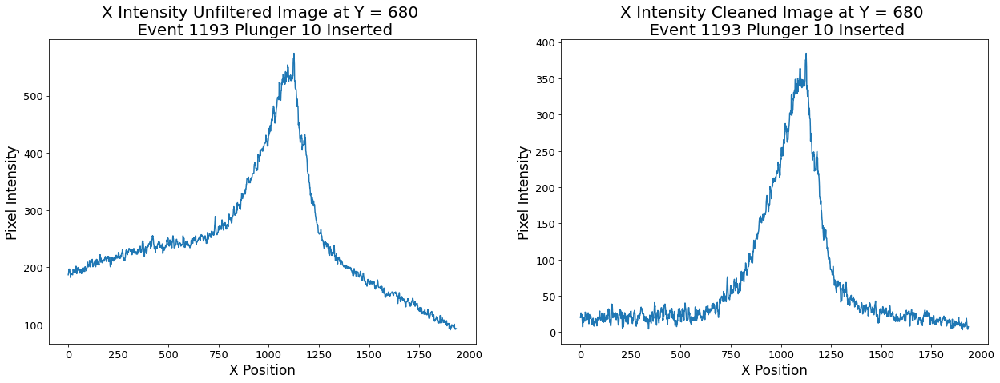

In [140]:
fig, axes = plt.subplots(1, 2, figsize=(21, 7))

x = np.arange(ex_data_plunger19.shape[1])
data_w_median_filter = ski.filters.median(ex_data_plunger19, footprint=disk(4)) 


## EVENT 963 
# First subplot
axes[0].plot(x,data_w_median_filter[680,:])
axes[0].set_title(f'X Intensity Unfiltered Image at Y = 680 \n Event 1193 Plunger 10 Inserted', fontsize=20)
axes[0].set_ylabel('Pixel Intensity',fontsize=17)
axes[0].set_xlabel('X Position',fontsize=17)

axes[1].plot(x,background_ex_nofilter_p10[680,:])
axes[1].set_title(f'X Intensity Cleaned Image at Y = 680 \n Event 1193 Plunger 10 Inserted', fontsize=20)
axes[1].set_ylabel('Pixel Intensity',fontsize=17)
axes[1].set_xlabel('X Position',fontsize=17)

axes[1].tick_params(axis='both', which='major', labelsize=13)
axes[0].tick_params(axis='both', which='major', labelsize=13)

Text(0.5, 1.0, 'Background Subtracted Image, Event 1063, 14.09.24')

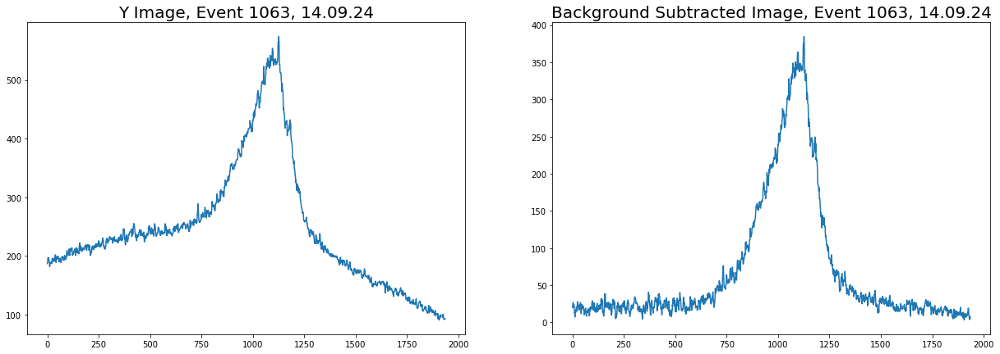

In [95]:
fig, axes = plt.subplots(1, 2, figsize=(21, 7))

x = np.arange(ex_data_plunger19.shape[1])
data_w_median_filter = ski.filters.median(ex_data_plunger19, footprint=disk(4)) 


## EVENT 963 
# First subplot
axes[0].plot(x,data_w_median_filter[680,:])
axes[0].set_title('Y Image, Event 1063, 14.09.24', fontsize=20)

axes[1].plot(x,background_ex_nofilter_p10[680,:])
axes[1].set_title('Background Subtracted Image, Event 1063, 14.09.24', fontsize=20)

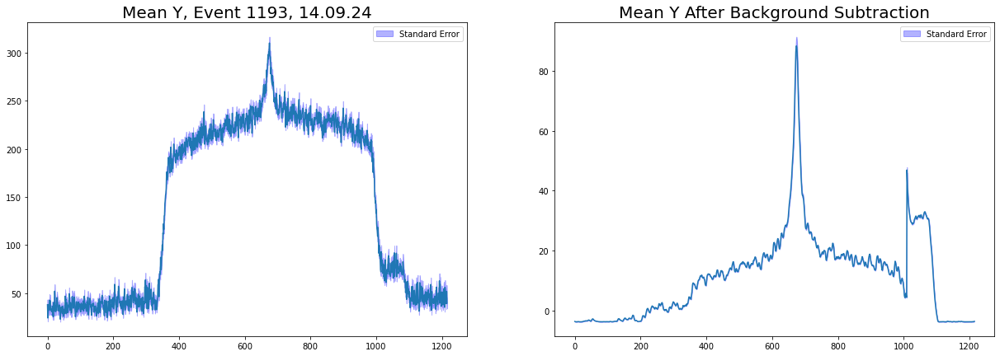

In [50]:
fig, axes = plt.subplots(1, 2, figsize=(21, 7))

mean_raw = np.mean(ex_data_plunger19,1)
N = ex_data_plunger19.shape[1]
std_raw = np.std(ex_data_plunger19,1)/(np.sqrt(N))

std_bg = np.std(background_ex_nofilter_p10,1)/(np.sqrt(N))
mean_bg = np.mean(background_ex_nofilter_p10,1)

x = np.arange(ex_data_plunger19.shape[0])

## EVENT 963 
# First subplot
axes[0].plot(x,mean_raw)
axes[0].set_title('Mean Y, Event 1193, 14.09.24', fontsize=20)
axes[0].fill_between(x, mean_raw - std_raw, mean_raw + std_raw, alpha=0.3, label='Standard Error',color='blue')
axes[0].legend()

axes[1].plot(x,mean_bg)
axes[1].set_title('Mean Y After Background Subtraction', fontsize=20)
axes[1].fill_between(x, mean_bg - std_bg, mean_bg + std_bg, alpha=0.3, label='Standard Error', color='blue')
axes[1].legend()

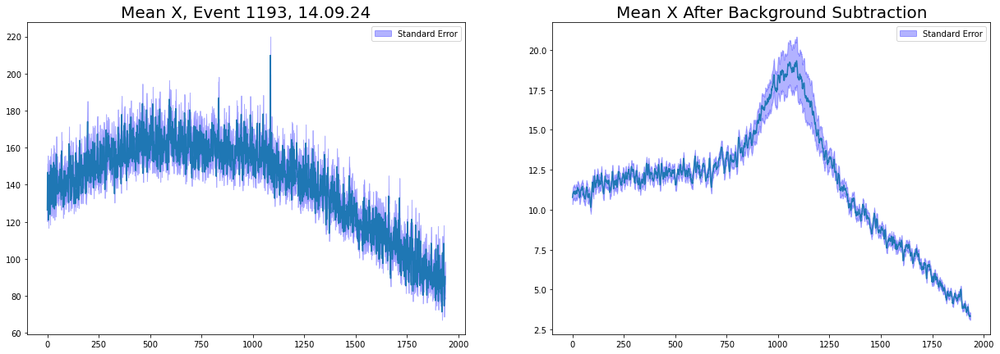

In [51]:
fig, axes = plt.subplots(1, 2, figsize=(21, 7))

mean_raw = np.mean(ex_data_plunger19,0)
N = ex_data_plunger19.shape[0]
std_raw = np.std(ex_data_plunger19,0)/(np.sqrt(N))

std_bg = np.std(background_ex_nofilter_p10,0)/(np.sqrt(N))
mean_bg = np.mean(background_ex_nofilter_p10,0)

x = np.arange(ex_data_plunger19.shape[1])

## EVENT 963 
# First subplot
axes[0].plot(x,mean_raw)
axes[0].set_title('Mean X, Event 1193, 14.09.24', fontsize=20)
axes[0].fill_between(x, mean_raw - std_raw, mean_raw + std_raw, alpha=0.3, label='Standard Error',color='blue')

axes[0].legend()

axes[1].plot(x,mean_bg)
axes[1].set_title('Mean X After Background Subtraction', fontsize=20)
axes[1].fill_between(x, mean_bg - std_bg, mean_bg + std_bg, alpha=0.3, label='Standard Error', color='blue')
axes[1].legend()


# CASE 4

In [ ]:
## RUN 2079

In [174]:
event_files[1206]

'1726328091735000000_Type0_2079_1.h5'

{'OTR': True, 'CTR': True, 'LDBP': 2, 'Plunger': 9} 1121740.937


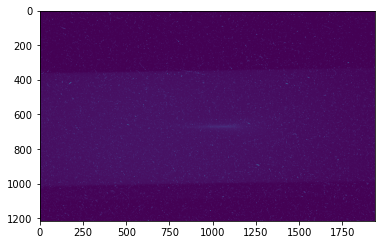

In [113]:
ex_data_plunger, protons, rif, laser, screens = load_all_event_data('2024/09/14',event_files[1215],spectro_no=2,threshold=1750000)
print(screens,rif)

plt.imshow(ex_data_plunger,vmax=4095)

1121740.937 {'OTR': True, 'CTR': True, 'LDBP': 2, 'Plunger': 9} 1 999


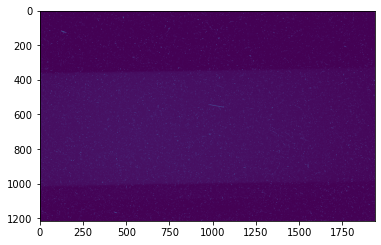

1121740.937 {'OTR': True, 'CTR': True, 'LDBP': 2, 'Plunger': 9} 0 1000


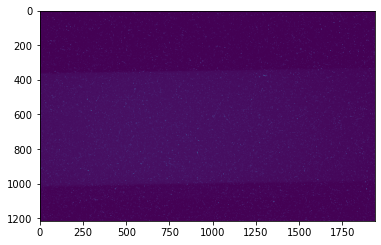

1121740.937 {'OTR': True, 'CTR': True, 'LDBP': 2, 'Plunger': 9} 0 1001


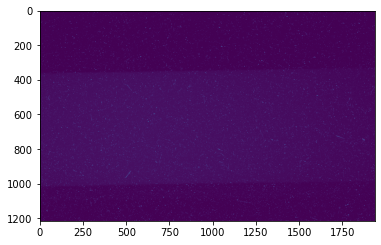

1121740.937 {'OTR': True, 'CTR': True, 'LDBP': 2, 'Plunger': 9} 1 1002


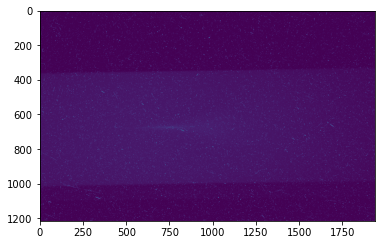

1121740.937 {'OTR': True, 'CTR': True, 'LDBP': 2, 'Plunger': 9} 1 1003


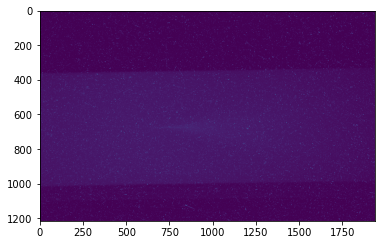

1121740.937 {'OTR': True, 'CTR': True, 'LDBP': 2, 'Plunger': 9} 1 1004


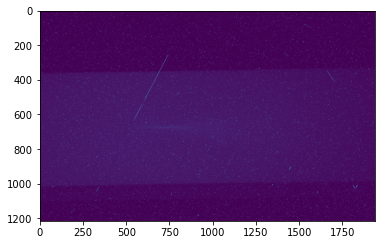

1121740.937 {'OTR': True, 'CTR': True, 'LDBP': 2, 'Plunger': 9} 1 1005


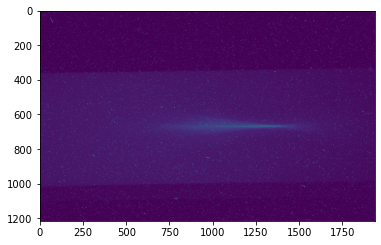

1121740.937 {'OTR': True, 'CTR': True, 'LDBP': 2, 'Plunger': 9} 1 1006


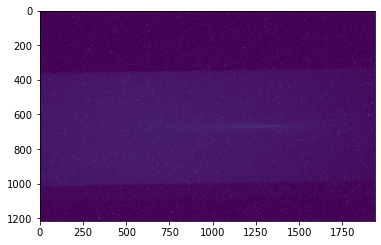

1121740.937 {'OTR': True, 'CTR': True, 'LDBP': 2, 'Plunger': 9} 1 1007


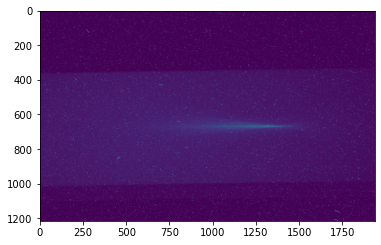

1121740.937 {'OTR': True, 'CTR': True, 'LDBP': 2, 'Plunger': 9} 1 1008


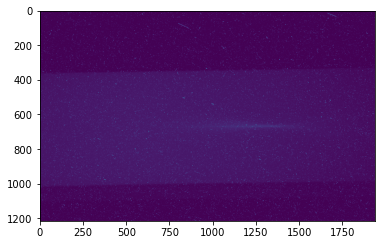

1121740.937 {'OTR': True, 'CTR': True, 'LDBP': 2, 'Plunger': 9} 1 1009


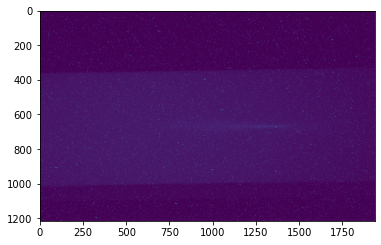

1121740.937 {'OTR': True, 'CTR': True, 'LDBP': 2, 'Plunger': 9} 1 1010


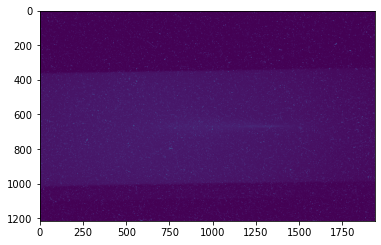

1121740.937 {'OTR': True, 'CTR': True, 'LDBP': 2, 'Plunger': 9} 1 1011


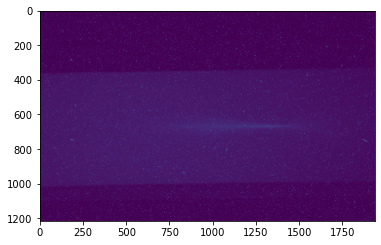

1121740.937 {'OTR': True, 'CTR': True, 'LDBP': 2, 'Plunger': 9} 0 1205


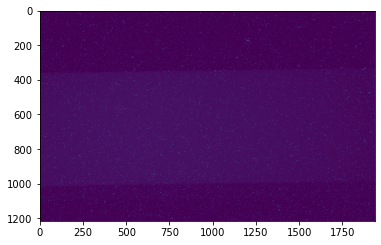

1121740.937 {'OTR': True, 'CTR': True, 'LDBP': 2, 'Plunger': 9} 0 1206


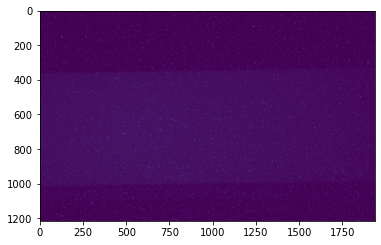

1121740.937 {'OTR': True, 'CTR': True, 'LDBP': 2, 'Plunger': 9} 0 1207


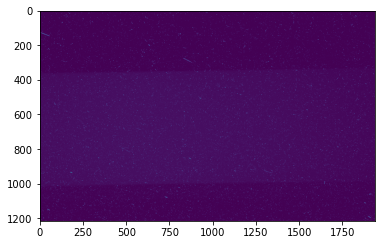

1121740.937 {'OTR': True, 'CTR': True, 'LDBP': 2, 'Plunger': 9} 1 1208


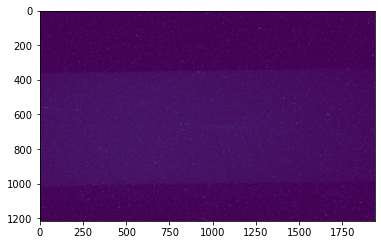

1121740.937 {'OTR': True, 'CTR': True, 'LDBP': 2, 'Plunger': 9} 1 1209


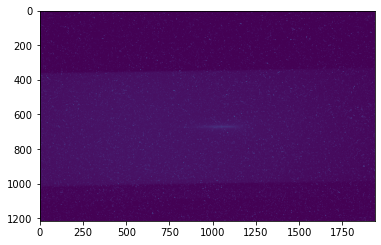

1121740.937 {'OTR': True, 'CTR': True, 'LDBP': 2, 'Plunger': 9} 1 1210


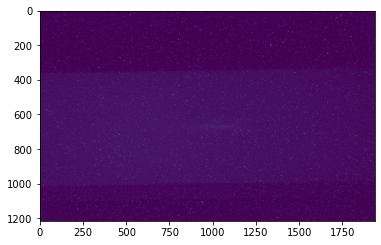

1121740.937 {'OTR': True, 'CTR': True, 'LDBP': 2, 'Plunger': 9} 1 1211


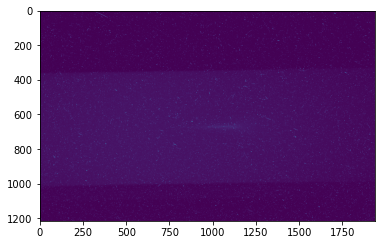

1121740.937 {'OTR': True, 'CTR': True, 'LDBP': 2, 'Plunger': 9} 1 1212


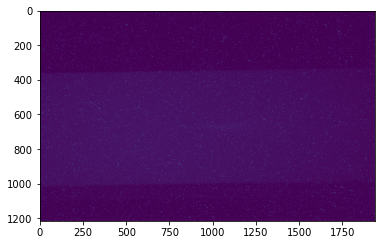

1121740.937 {'OTR': True, 'CTR': True, 'LDBP': 2, 'Plunger': 9} 1 1213


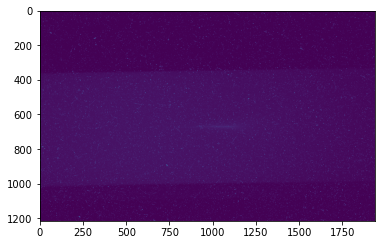

1121740.937 {'OTR': True, 'CTR': True, 'LDBP': 2, 'Plunger': 9} 1 1214


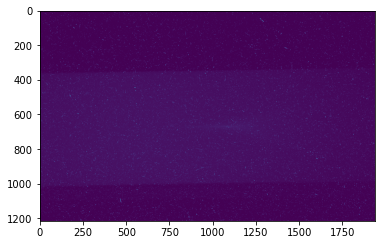

1121740.937 {'OTR': True, 'CTR': True, 'LDBP': 2, 'Plunger': 9} 1 1215


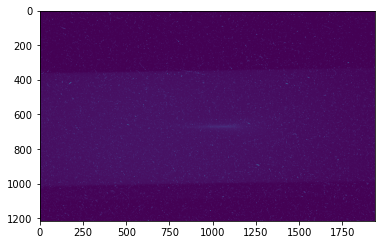

1121740.937 {'OTR': True, 'CTR': True, 'LDBP': 2, 'Plunger': 9} 1 1216


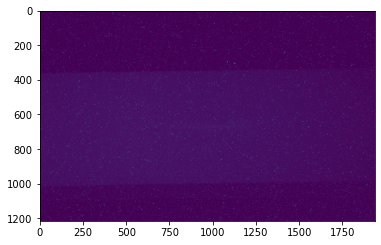

1121740.937 {'OTR': True, 'CTR': True, 'LDBP': 2, 'Plunger': 9} 1 1217


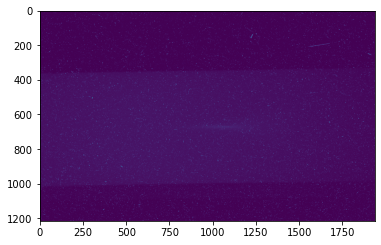

1121740.937 {'OTR': True, 'CTR': True, 'LDBP': 2, 'Plunger': 9} 1 1218


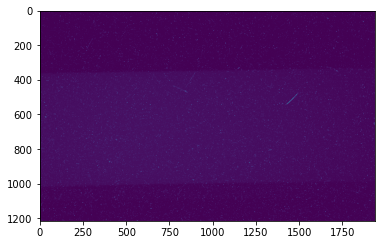

In [183]:
for i in np.arange(0,len(event_files),1):
    
    ex_data, protons, rif, laser, screens = load_all_event_data('2024/09/14',event_files[i],spectro_no=2,threshold=1750000)
    
    if screens['LDBP'] != 0 and screens['Plunger'] == 9 and rif == 1121740.937:
        print(rif, screens, laser, i)
        
        plt.imshow(ex_data,vmax=4095)
        plt.show()

In [184]:
 ## 1205 - 1207

In [41]:
test_14_09_p9 = sort_by_space_scin_screen(680,1936,1205,1208,'2024/09/14',2)

In [189]:
test_14_09_p9

{1121740.937: {0: {'Plunger9': {'full_image': {'fit_parameters': [123.55823856685215,
      121.65385868056929,
      115.78747549907409],
     'proton_count': [28.766771, 28.254484, 27.009542]},
    (330,
     331,
     0,
     1): {'fit_parameters': [0.21873721000000002,
      -2.78126279,
      -2.78126279], 'proton_count': [28.766771, 28.254484, 27.009542]},
    (330,
     331,
     1,
     2): {'fit_parameters': [-1.78126279,
      -2.78126279,
      -3.78126279], 'proton_count': [28.766771, 28.254484, 27.009542]},
    (330,
     331,
     2,
     3): {'fit_parameters': [-1.78126279,
      -2.78126279,
      -2.78126279], 'proton_count': [28.766771, 28.254484, 27.009542]},
    (330,
     331,
     3,
     4): {'fit_parameters': [-2.78126279,
      -0.78126279,
      -2.78126279], 'proton_count': [28.766771, 28.254484, 27.009542]},
    (330,
     331,
     4,
     5): {'fit_parameters': [-3.78126279,
      -2.78126279,
      -0.78126279], 'proton_count': [28.766771, 28.254484, 27.0

In [42]:
fit_to_spectrometer_no_filter(test_14_09_p9, 3,'2024/09/14',2)

/tmp/ipykernel_591/3950915343.py:27: OptimizeWarning: Covariance of the parameters could not be estimated
  params,pcov = curve_fit(fit_line, x, y)


'Your dataset has been saved'

In [112]:
background_ex_nofilter_p9 = background_subtraction_nofilter('2024/09/14',1215, 2, threshold=1.75e6,stored_event=3)

NpzFile 'slope_intercept_data_2024-09-14_Spectro_2_Upto_Event_3_nofilter.npz' with keys: RIF_1121740.937_Laser_0_Screens_Plunger9_slope, RIF_1121740.937_Laser_0_Screens_Plunger9_intercepts
Shapes - slopes: (1216, 1936) intercepts: (1216, 1936) data: (1216, 1936)
Protons: 27.800869


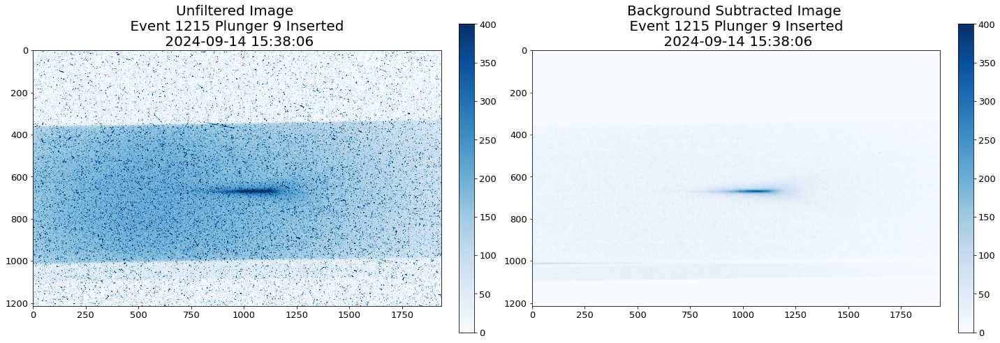

In [115]:
fig, axes = plt.subplots(1, 2, figsize=(20, 15))

selectedEvent = os.path.join(DATA_PATH, event_files[1215])
stamp = int(selectedEvent[44:63])
timestamp = pd.to_datetime(stamp)
formatted_timestamp = timestamp.strftime('%Y-%m-%d %H:%M:%S')

# EVENT 963 
# First subplot
im1 = axes[0].imshow(ex_data_plunger, cmap='Blues', vmin=0,vmax=400)
axes[0].set_title(f'Unfiltered Image \n Event 1215 Plunger 9 Inserted \n {formatted_timestamp}', fontsize=20)
cbar1 = fig.colorbar(im1, ax=axes[0], fraction=0.035, pad=0.04)
cbar1.ax.tick_params(labelsize=13)


# Second subplot
im2 = axes[1].imshow(background_ex_nofilter_p9, cmap='Blues', vmin=0, vmax=400)
axes[1].set_title(f'Background Subtracted Image \n Event 1215 Plunger 9 Inserted \n {formatted_timestamp}', fontsize=20)
cbar = fig.colorbar(im2, ax=axes[1], fraction=0.035, pad=0.04)
cbar.ax.tick_params(labelsize=13)

axes[1].tick_params(axis='both', which='major', labelsize=13)
axes[0].tick_params(axis='both', which='major', labelsize=13)


plt.tight_layout()
plt.show()

Text(0.5, 1.0, 'Background Subtracted Image, Event 1063, 14.09.24')

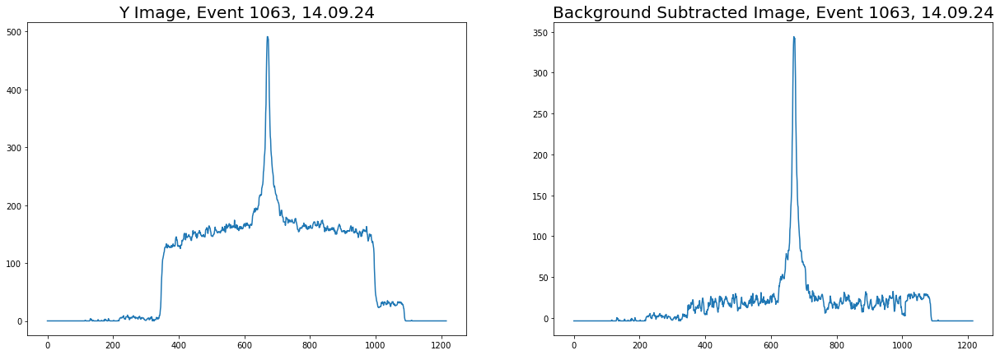

In [116]:
fig, axes = plt.subplots(1, 2, figsize=(21, 7))

x = np.arange(ex_data_plunger.shape[0])
data_w_median_filter = ski.filters.median(ex_data_plunger, footprint=disk(4)) 


## EVENT 963 
# First subplot
axes[0].plot(x,data_w_median_filter[:,1050])
axes[0].set_title('Y Image, Event 1215, 14.09.24', fontsize=20)

axes[1].plot(x,background_ex_nofilter_p9[:,1050])
axes[1].set_title('Background Subtracted Image, Event 1215, 14.09.24', fontsize=20)

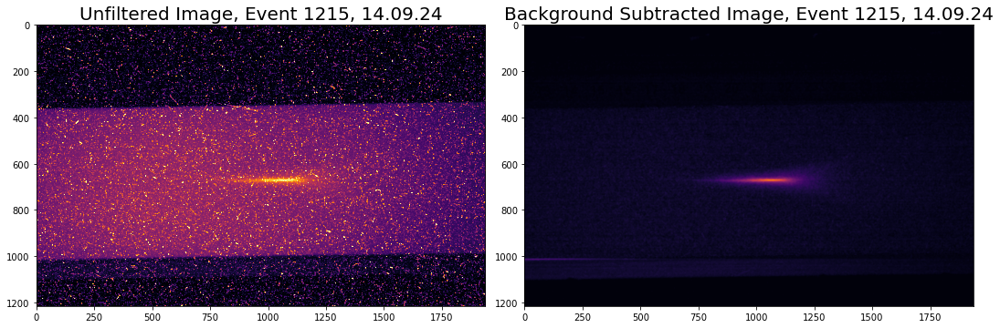

In [47]:
fig, axes = plt.subplots(1, 2, figsize=(15, 10))

## EVENT 963 
# First subplot
axes[0].imshow(ex_data_plunger,cmap='inferno', vmax=500)
axes[0].set_title('Unfiltered Image, Event 1215, 14.09.24', fontsize=20)

# Second subplot
axes[1].imshow(background_ex_nofilter_p9,cmap='inferno',vmax=500)
axes[1].set_title('Background Subtracted Image, Event 1215, 14.09.24', fontsize=20)

plt.tight_layout()
plt.show()

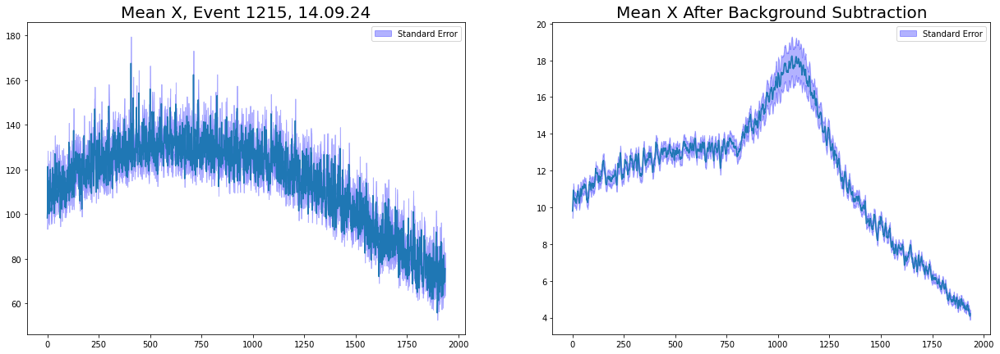

In [48]:
fig, axes = plt.subplots(1, 2, figsize=(21, 7))

mean_raw = np.mean(ex_data_plunger,0)
N = ex_data_plunger.shape[0]
std_raw = np.std(ex_data_plunger,0)/(np.sqrt(N))

std_bg = np.std(background_ex_nofilter_p9,0)/(np.sqrt(N))
mean_bg = np.mean(background_ex_nofilter_p9,0)

x = np.arange(ex_data_plunger.shape[1])

## EVENT 963 
# First subplot
axes[0].plot(x,mean_raw)
axes[0].set_title('Mean X, Event 1215, 14.09.24', fontsize=20)
axes[0].fill_between(x, mean_raw - std_raw, mean_raw + std_raw, alpha=0.3, label='Standard Error',color='blue')

axes[0].legend()

axes[1].plot(x,mean_bg)
axes[1].set_title('Mean X After Background Subtraction', fontsize=20)
axes[1].fill_between(x, mean_bg - std_bg, mean_bg + std_bg, alpha=0.3, label='Standard Error', color='blue')

axes[1].legend()

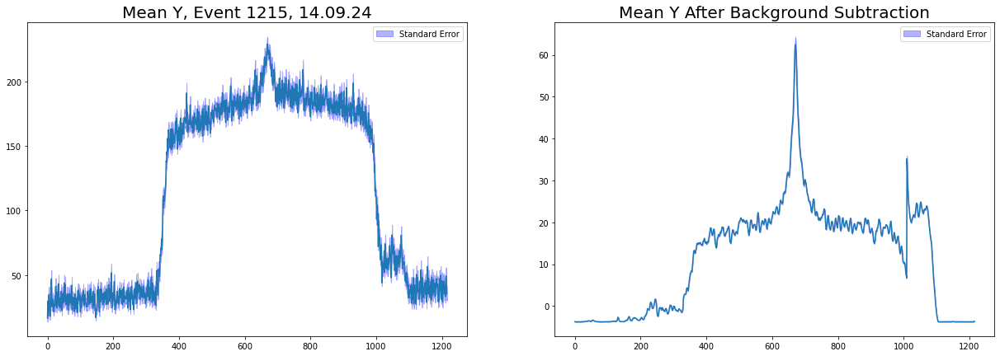

In [49]:
fig, axes = plt.subplots(1, 2, figsize=(21, 7))

mean_raw = np.mean(ex_data_plunger,1)
N = ex_data_plunger.shape[1]
std_raw = np.std(ex_data_plunger,1)/(np.sqrt(N))

std_bg = np.std(background_ex_nofilter_p9,1)/(np.sqrt(N))
mean_bg = np.mean(background_ex_nofilter_p9,1)

x = np.arange(ex_data_plunger.shape[0])

## EVENT 963 
# First subplot
axes[0].plot(x,mean_raw)
axes[0].set_title('Mean Y, Event 1215, 14.09.24', fontsize=20)
axes[0].fill_between(x, mean_raw - std_raw, mean_raw + std_raw, alpha=0.3, label='Standard Error',color='blue')
axes[0].legend()

axes[1].plot(x,mean_bg)
axes[1].set_title('Mean Y After Background Subtraction', fontsize=20)
axes[1].fill_between(x, mean_bg - std_bg, mean_bg + std_bg, alpha=0.3, label='Standard Error', color='blue')
axes[1].legend()

# CASE 5

In [211]:
event_files[1063]

'1726321093335000000_Type0_2069_6.h5'

{'OTR': True, 'CTR': True, 'LDBP': 2, 'Plunger': 8} 1121740.937


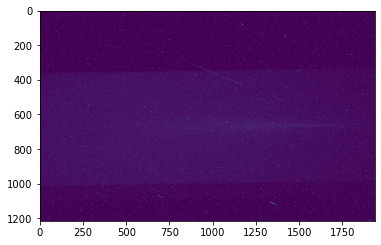

In [58]:
ex_data_plunger, protons, rif, laser, screens = load_all_event_data('2024/09/14',event_files[1063],spectro_no=2,threshold=1750000)
print(screens,rif)

plt.imshow(ex_data_plunger,vmax=4095)

1121740.937 {'OTR': True, 'CTR': True, 'LDBP': 2, 'Plunger': 8} 0 1046


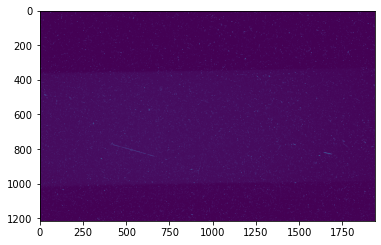

1121740.937 {'OTR': True, 'CTR': True, 'LDBP': 2, 'Plunger': 8} 0 1047


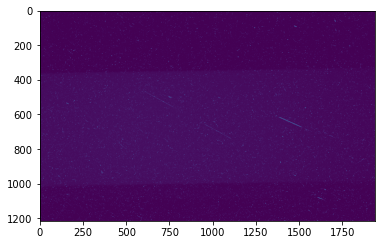

1121740.937 {'OTR': True, 'CTR': True, 'LDBP': 2, 'Plunger': 8} 0 1048


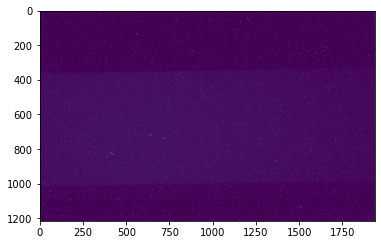

1121740.937 {'OTR': True, 'CTR': True, 'LDBP': 2, 'Plunger': 8} 0 1049


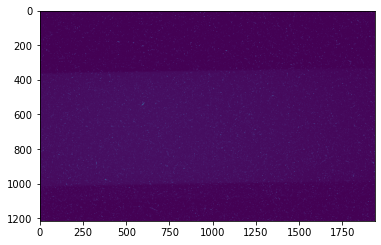

1121740.937 {'OTR': True, 'CTR': True, 'LDBP': 2, 'Plunger': 8} 0 1050


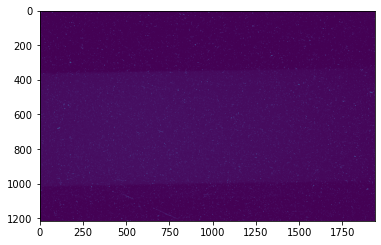

1121740.937 {'OTR': True, 'CTR': True, 'LDBP': 2, 'Plunger': 8} 0 1051


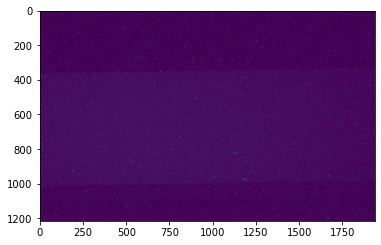

1121740.937 {'OTR': True, 'CTR': True, 'LDBP': 2, 'Plunger': 8} 0 1052


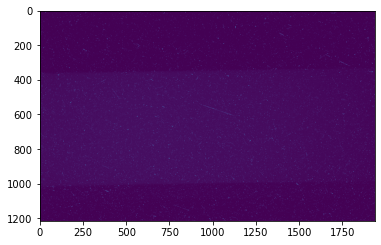

1121740.937 {'OTR': True, 'CTR': True, 'LDBP': 2, 'Plunger': 8} 0 1053


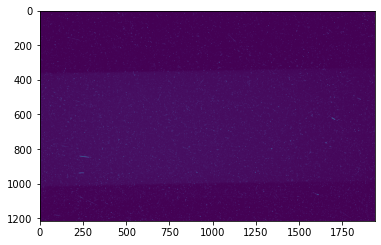

1121740.937 {'OTR': True, 'CTR': True, 'LDBP': 2, 'Plunger': 8} 0 1054


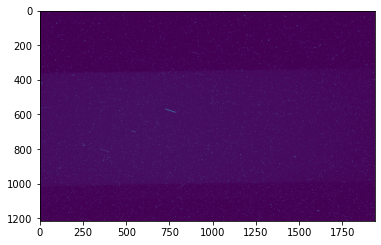

1121740.937 {'OTR': True, 'CTR': True, 'LDBP': 2, 'Plunger': 8} 0 1055


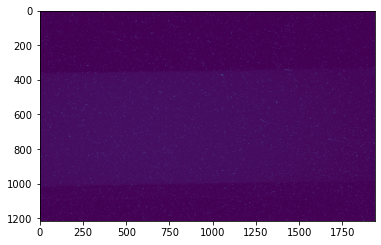

1121740.937 {'OTR': True, 'CTR': True, 'LDBP': 2, 'Plunger': 8} 0 1056


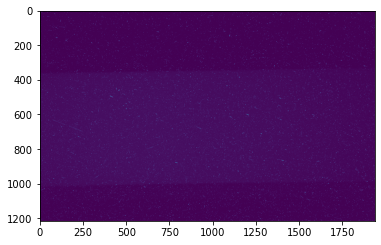

1121740.937 {'OTR': True, 'CTR': True, 'LDBP': 2, 'Plunger': 8} 0 1057


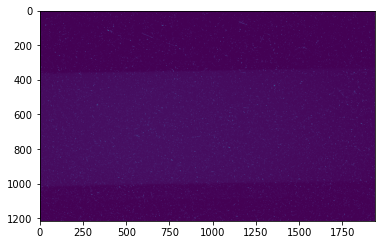

1121740.937 {'OTR': True, 'CTR': True, 'LDBP': 2, 'Plunger': 8} 0 1058


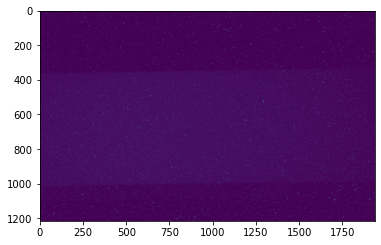

1121740.937 {'OTR': True, 'CTR': True, 'LDBP': 2, 'Plunger': 8} 1 1059


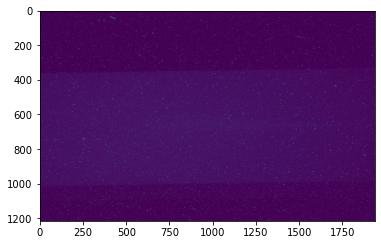

1121740.937 {'OTR': True, 'CTR': True, 'LDBP': 2, 'Plunger': 8} 1 1060


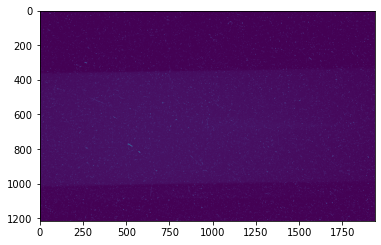

1121740.937 {'OTR': True, 'CTR': True, 'LDBP': 2, 'Plunger': 8} 1 1061


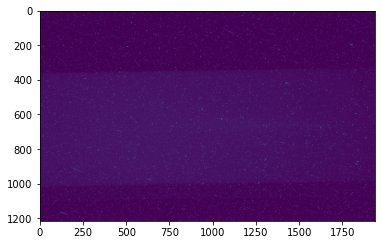

1121740.937 {'OTR': True, 'CTR': True, 'LDBP': 2, 'Plunger': 8} 1 1062


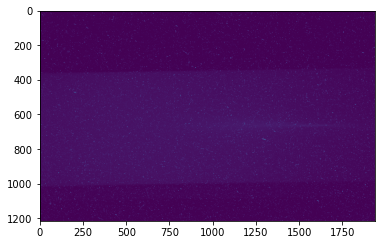

1121740.937 {'OTR': True, 'CTR': True, 'LDBP': 2, 'Plunger': 8} 1 1063


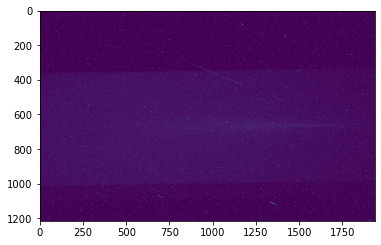

1121740.937 {'OTR': True, 'CTR': True, 'LDBP': 2, 'Plunger': 8} 1 1064


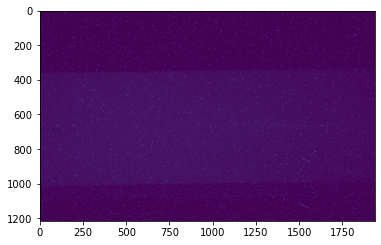

1121740.937 {'OTR': True, 'CTR': True, 'LDBP': 2, 'Plunger': 8} 1 1065


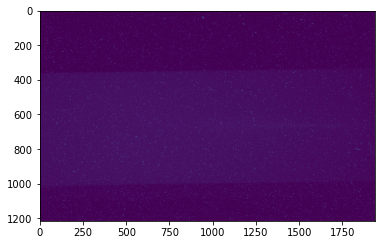

1121740.937 {'OTR': True, 'CTR': True, 'LDBP': 2, 'Plunger': 8} 1 1066


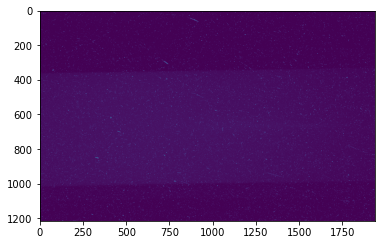

1121740.937 {'OTR': True, 'CTR': True, 'LDBP': 2, 'Plunger': 8} 1 1067


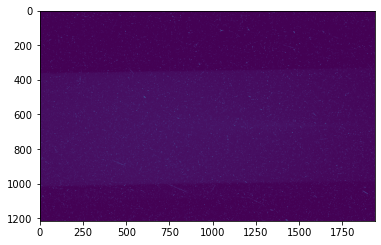

1121740.937 {'OTR': True, 'CTR': True, 'LDBP': 2, 'Plunger': 8} 1 1068


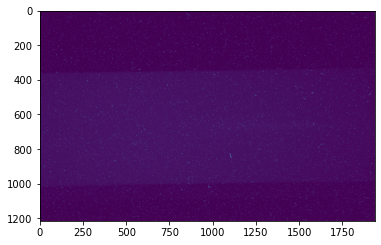

1121740.937 {'OTR': True, 'CTR': True, 'LDBP': 2, 'Plunger': 8} 0 1069


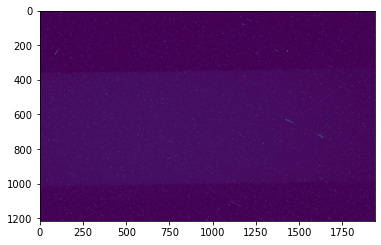

1121740.937 {'OTR': True, 'CTR': True, 'LDBP': 2, 'Plunger': 8} 0 1226


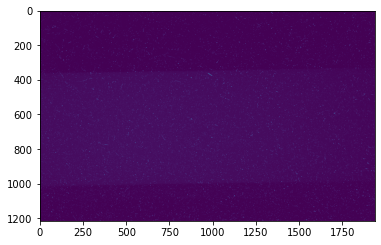

1121740.937 {'OTR': True, 'CTR': True, 'LDBP': 2, 'Plunger': 8} 1 1227


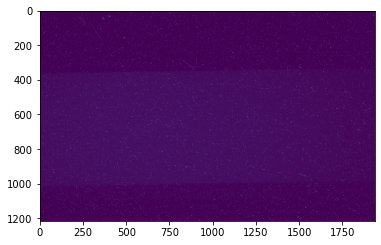

1121740.937 {'OTR': True, 'CTR': True, 'LDBP': 2, 'Plunger': 8} 1 1228


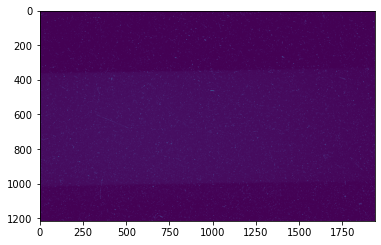

1121740.937 {'OTR': True, 'CTR': True, 'LDBP': 2, 'Plunger': 8} 1 1229


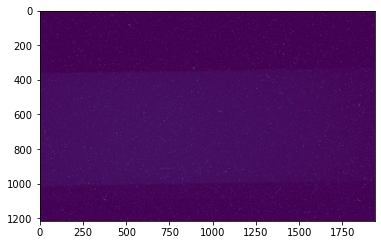

1121740.937 {'OTR': True, 'CTR': True, 'LDBP': 2, 'Plunger': 8} 1 1230


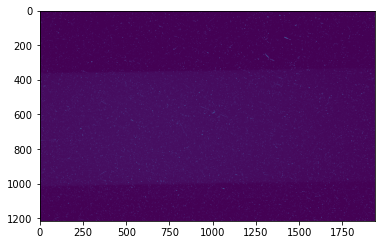

1121740.937 {'OTR': True, 'CTR': True, 'LDBP': 2, 'Plunger': 8} 1 1231


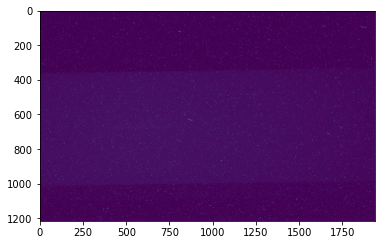

1121740.937 {'OTR': True, 'CTR': True, 'LDBP': 2, 'Plunger': 8} 1 1232


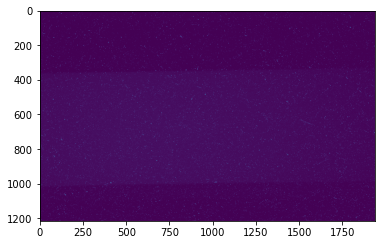

1121740.937 {'OTR': True, 'CTR': True, 'LDBP': 2, 'Plunger': 8} 1 1233


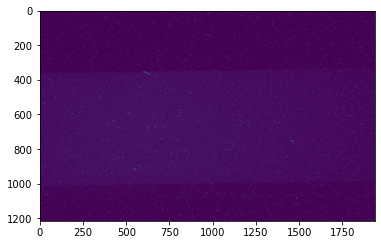

1121740.937 {'OTR': True, 'CTR': True, 'LDBP': 2, 'Plunger': 8} 1 1234


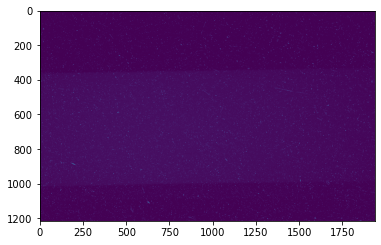

1121740.937 {'OTR': True, 'CTR': True, 'LDBP': 2, 'Plunger': 8} 1 1235


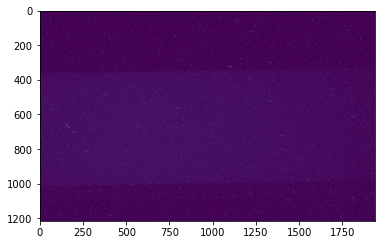

1121740.937 {'OTR': True, 'CTR': True, 'LDBP': 2, 'Plunger': 8} 1 1236


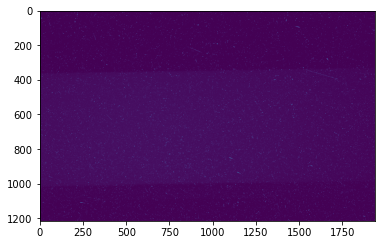

1121740.937 {'OTR': True, 'CTR': True, 'LDBP': 2, 'Plunger': 8} 1 1237


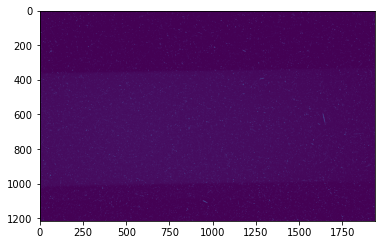

In [209]:
for i in np.arange(1000,len(event_files),1):
    
    ex_data, protons, rif, laser, screens = load_all_event_data('2024/09/14',event_files[i],spectro_no=2,threshold=1750000)
    
    if screens['LDBP'] != 0 and screens['Plunger'] == 8 and rif == 1121740.937:
        print(rif, screens, laser, i)
        
        plt.imshow(ex_data)
        plt.show()

In [212]:
## RUN 2069 : 1063      ## 1058 1046

In [213]:
test_14_09_p98_69 = sort_by_space_scin_screen(680,1936,1048,1058,'2024/09/14',2)

In [214]:
fit_to_spectrometer_no_filter(test_14_09_p98_69, 10,'2024/09/14',2)

/tmp/ipykernel_469/2787405286.py:37: OptimizeWarning: Covariance of the parameters could not be estimated
  params = curve_fit(fit_line, x, y)[0]


'Your dataset has been saved'

In [104]:
background_ex_nofilter_p8 = background_subtraction_nofilter('2024/09/14',1063, 2, threshold=1.75e6,stored_event=10)

NpzFile 'slope_intercept_data_2024-09-14_Spectro_2_Upto_Event_10_nofilter.npz' with keys: RIF_1121740.937_Laser_0_Screens_Plunger8_slope, RIF_1121740.937_Laser_0_Screens_Plunger8_intercepts
Shapes - slopes: (1216, 1936) intercepts: (1216, 1936) data: (1216, 1936)
Protons: 27.478899


In [108]:
ex_data_plunger, protons, rif, laser, screens = load_all_event_data('2024/09/14',event_files[1063],spectro_no=2,threshold=1750000)

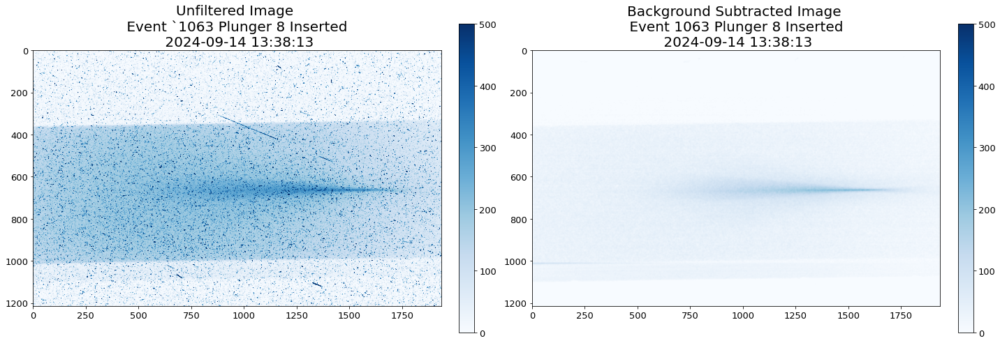

In [106]:
fig, axes = plt.subplots(1, 2, figsize=(20, 15))

selectedEvent = os.path.join(DATA_PATH, event_files[1063])
stamp = int(selectedEvent[44:63])
timestamp = pd.to_datetime(stamp)
formatted_timestamp = timestamp.strftime('%Y-%m-%d %H:%M:%S')

# EVENT 963 
# First subplot
im1 = axes[0].imshow(ex_data_plunger, cmap='Blues', vmin=0,vmax=500)
axes[0].set_title(f'Unfiltered Image \n Event `1063 Plunger 8 Inserted \n {formatted_timestamp}', fontsize=20)
cbar1 = fig.colorbar(im1, ax=axes[0], fraction=0.035, pad=0.04)
cbar1.ax.tick_params(labelsize=13)


# Second subplot
im2 = axes[1].imshow(background_ex_nofilter_p8, cmap='Blues', vmin=0, vmax=500)
axes[1].set_title(f'Background Subtracted Image \n Event 1063 Plunger 8 Inserted \n {formatted_timestamp}', fontsize=20)
cbar = fig.colorbar(im2, ax=axes[1], fraction=0.035, pad=0.04)
cbar.ax.tick_params(labelsize=13)

axes[1].tick_params(axis='both', which='major', labelsize=13)
axes[0].tick_params(axis='both', which='major', labelsize=13)


plt.tight_layout()
plt.show()

Text(0.5, 1.0, 'Background Subtracted Image, Event 1063, 14.09.24')

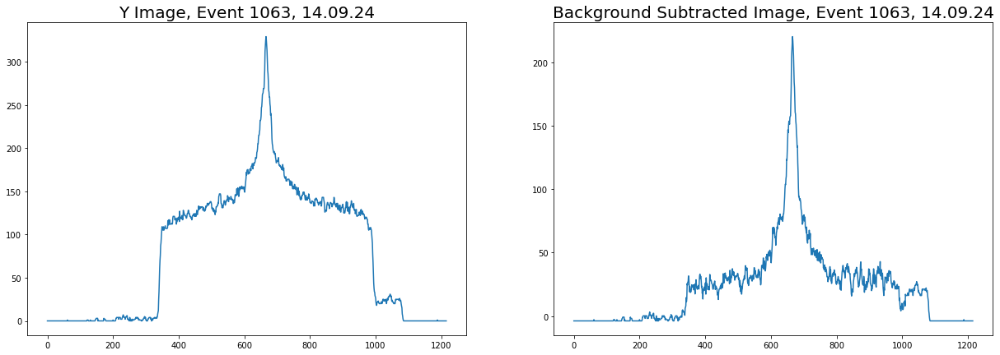

In [111]:
fig, axes = plt.subplots(1, 2, figsize=(21, 7))

x = np.arange(ex_data_plunger.shape[0])
data_w_median_filter = ski.filters.median(ex_data_plunger, footprint=disk(4)) 


## EVENT 963 
# First subplot
axes[0].plot(x,data_w_median_filter[:,1400])
axes[0].set_title('Y Image, Event 1063, 14.09.24', fontsize=20)

axes[1].plot(x,background_ex_nofilter_p8[:,1400])
axes[1].set_title('Background Subtracted Image, Event 1063, 14.09.24', fontsize=20)

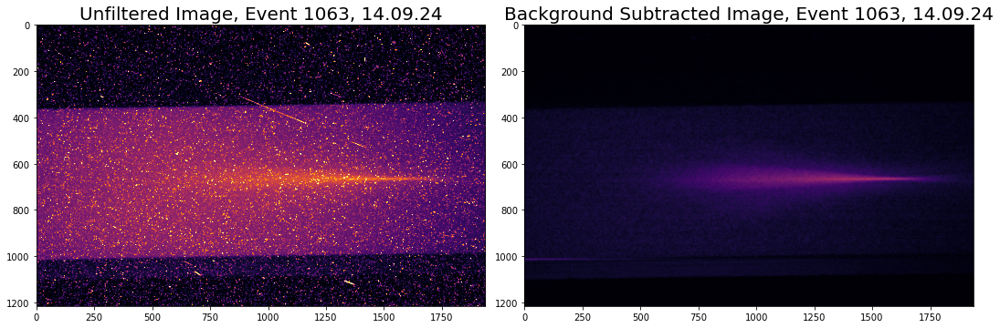

In [60]:
fig, axes = plt.subplots(1, 2, figsize=(15, 10))

## EVENT 963 
# First subplot
axes[0].imshow(ex_data_plunger, cmap='inferno', vmax=500)
axes[0].set_title('Unfiltered Image, Event 1063, 14.09.24', fontsize=20)

# Second subplot
axes[1].imshow(background_ex_nofilter_p8,cmap='inferno', vmax=500)
axes[1].set_title('Background Subtracted Image, Event 1063, 14.09.24', fontsize=20)


plt.tight_layout()
plt.show()

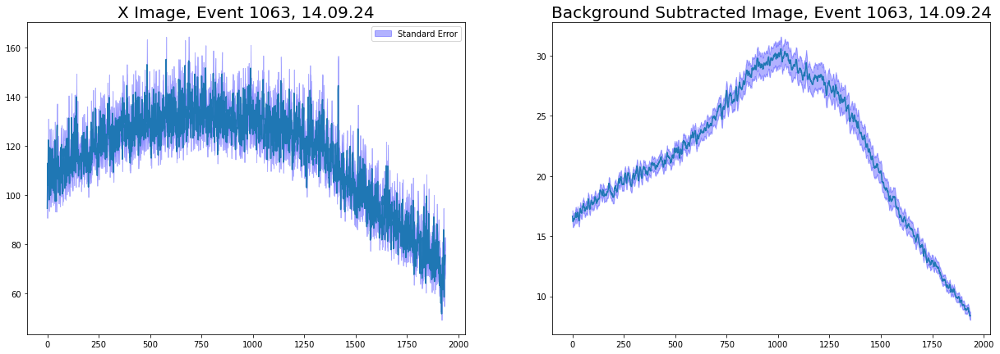

In [79]:
fig, axes = plt.subplots(1, 2, figsize=(21, 7))

mean_raw = np.mean(ex_data_plunger,0)
N = ex_data_plunger.shape[0]
std_raw = np.std(ex_data_plunger,0)/(np.sqrt(N))

std_bg = np.std(background_ex_nofilter_p8,0)/(np.sqrt(N))
mean_bg = np.mean(background_ex_nofilter_p8,0)

x = np.arange(ex_data_plunger.shape[1])

## EVENT 963 
# First subplot
axes[0].plot(x,mean_raw)
axes[0].set_title('X Image, Event 1063, 14.09.24', fontsize=20)
axes[0].fill_between(x, mean_raw - std_raw, mean_raw + std_raw, alpha=0.3, label='Standard Error',color='blue')

axes[0].legend()

axes[1].plot(x,mean_bg)
axes[1].set_title('Background Subtracted Image, Event 1063, 14.09.24', fontsize=20)
axes[1].fill_between(x, mean_bg - std_bg, mean_bg + std_bg, alpha=0.3, label='Standard Error', color='blue')

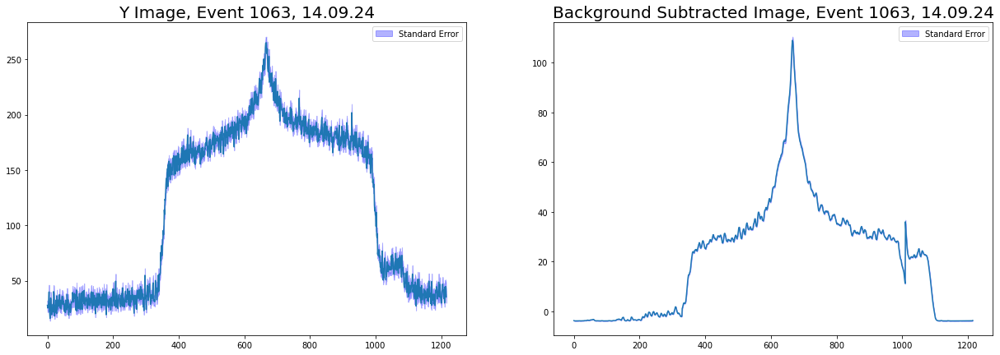

In [78]:
fig, axes = plt.subplots(1, 2, figsize=(21, 7))

mean_raw = np.mean(ex_data_plunger,1)
N = ex_data_plunger.shape[1]
std_raw = np.std(ex_data_plunger,1)/(np.sqrt(N))

std_bg = np.std(background_ex_nofilter_p8,1)/(np.sqrt(N))
mean_bg = np.mean(background_ex_nofilter_p8,1)

x = np.arange(ex_data_plunger.shape[0])

## EVENT 963 
# First subplot
axes[0].plot(x,mean_raw)
axes[0].set_title('Y Image, Event 1063, 14.09.24', fontsize=20)
axes[0].fill_between(x, mean_raw - std_raw, mean_raw + std_raw, alpha=0.3, label='Standard Error',color='blue')
axes[0].legend()

axes[1].plot(x,mean_bg)
axes[1].set_title('Background Subtracted Image, Event 1063, 14.09.24', fontsize=20)
axes[1].fill_between(x, mean_bg - std_bg, mean_bg + std_bg, alpha=0.3, label='Standard Error', color='blue')
axes[1].legend()

## CASE 6 - Low charge capture

{'OTR': True, 'CTR': True, 'LDBP': 2, 'Plunger': 8} 1121740.937


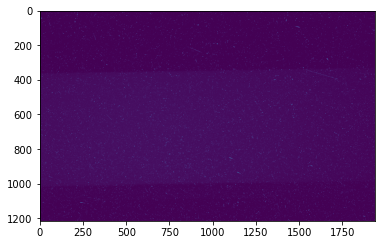

In [226]:
ex_data_plunger, protons, rif, laser, screens = load_all_event_data('2024/09/14',event_files[1236],spectro_no=2,threshold=1750000)
print(screens,rif)

plt.imshow(ex_data_plunger,vmax=4095)

In [227]:
background_ex_nofilter_p8_2 = background_subtraction_nofilter('2024/09/14',1236, 2, threshold=1.75e6)

Shapes - slopes: (1216, 1936) intercepts: (1216, 1936) data: (1216, 1936)
Protons: 28.11139


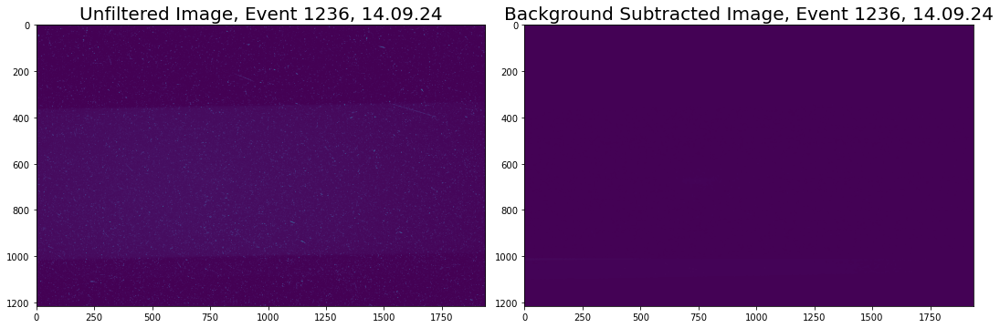

In [228]:
fig, axes = plt.subplots(1, 2, figsize=(15, 10))

## EVENT 963 
# First subplot
axes[0].imshow(ex_data_plunger, vmax=4095)
axes[0].set_title('Unfiltered Image, Event 1236, 14.09.24', fontsize=20)

# Second subplot
axes[1].imshow(background_ex_nofilter_p8_2, vmax=4095)
axes[1].set_title('Background Subtracted Image, Event 1236, 14.09.24', fontsize=20)

plt.tight_layout()
plt.show()

# CASE 7 -LBDP Back in

In [ ]:
## RUN 2075

In [232]:
event_files[1170]

'1726327314135000000_Type0_2075_8.h5'

{'OTR': True, 'CTR': True, 'LDBP': 0, 'Plunger': None} 1121740.937


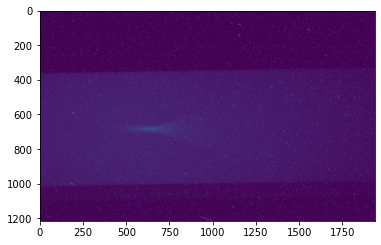

In [118]:
ex_data_plunger, protons, rif, laser, screens = load_all_event_data('2024/09/14',event_files[1170],spectro_no=2,threshold=1750000)
print(screens,rif)

plt.imshow(ex_data_plunger,vmax=4095)

1121740.937 {'OTR': True, 'CTR': True, 'LDBP': 0, 'Plunger': None} 0 1159


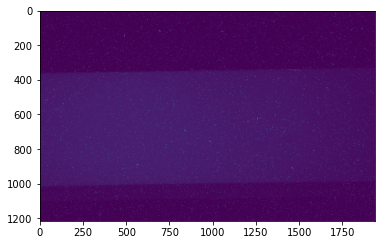

1121740.937 {'OTR': True, 'CTR': True, 'LDBP': 0, 'Plunger': None} 0 1160


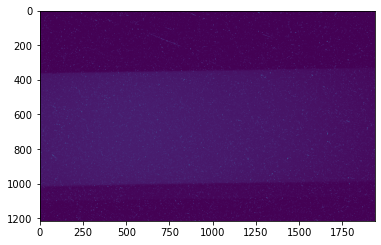

1121740.937 {'OTR': True, 'CTR': True, 'LDBP': 0, 'Plunger': None} 0 1161


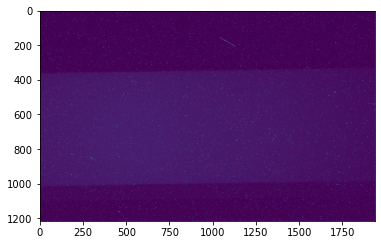

1121740.937 {'OTR': True, 'CTR': True, 'LDBP': 0, 'Plunger': None} 0 1162


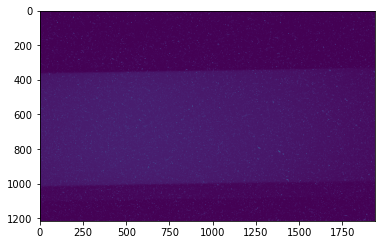

1121740.937 {'OTR': True, 'CTR': True, 'LDBP': 0, 'Plunger': None} 0 1163


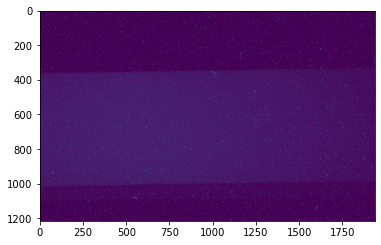

1121740.937 {'OTR': True, 'CTR': True, 'LDBP': 0, 'Plunger': None} 1 1164


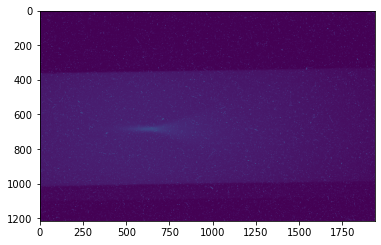

1121740.937 {'OTR': True, 'CTR': True, 'LDBP': 0, 'Plunger': None} 1 1165


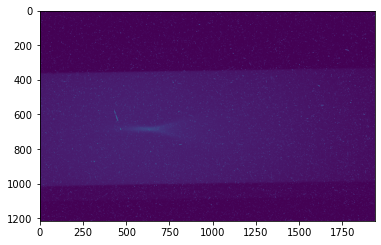

1121740.937 {'OTR': True, 'CTR': True, 'LDBP': 0, 'Plunger': None} 1 1166


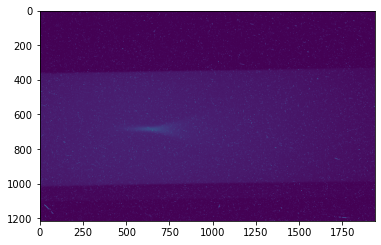

1121740.937 {'OTR': True, 'CTR': True, 'LDBP': 0, 'Plunger': None} 1 1167


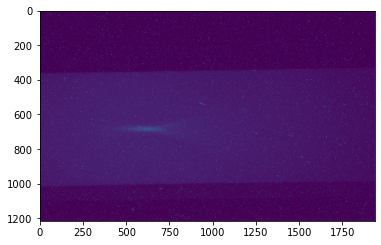

1121740.937 {'OTR': True, 'CTR': True, 'LDBP': 0, 'Plunger': None} 1 1168


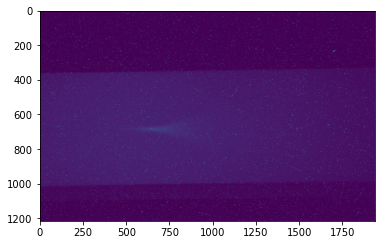

1121740.937 {'OTR': True, 'CTR': True, 'LDBP': 0, 'Plunger': None} 1 1169


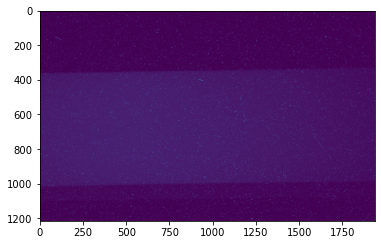

1121740.937 {'OTR': True, 'CTR': True, 'LDBP': 0, 'Plunger': None} 1 1170


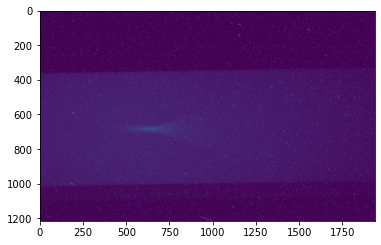

1121740.937 {'OTR': True, 'CTR': True, 'LDBP': 0, 'Plunger': None} 1 1171


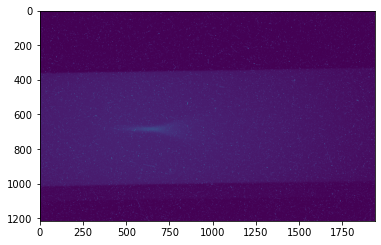

1121740.937 {'OTR': True, 'CTR': True, 'LDBP': 0, 'Plunger': None} 1 1172


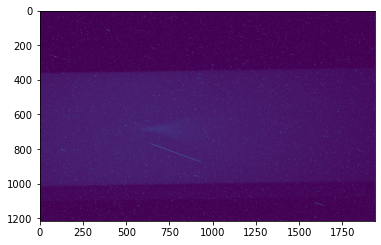

1121740.937 {'OTR': True, 'CTR': True, 'LDBP': 0, 'Plunger': None} 1 1173


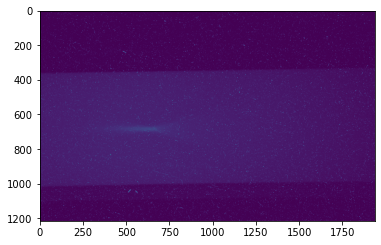

1121740.937 {'OTR': True, 'CTR': True, 'LDBP': 0, 'Plunger': None} 1 1174


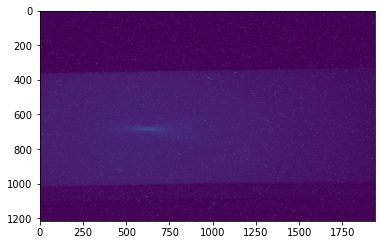

1121740.937 {'OTR': True, 'CTR': True, 'LDBP': 0, 'Plunger': None} 1 1175


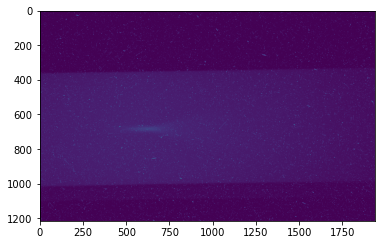

1121740.937 {'OTR': True, 'CTR': True, 'LDBP': 0, 'Plunger': None} 1 1176


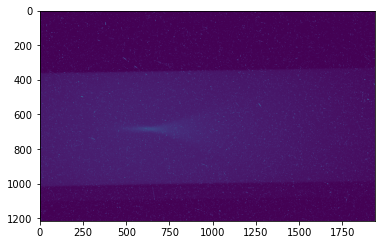

1121740.937 {'OTR': True, 'CTR': True, 'LDBP': 0, 'Plunger': None} 1 1177


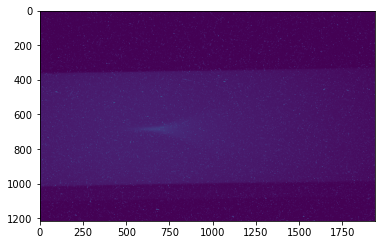

1121740.937 {'OTR': True, 'CTR': True, 'LDBP': 0, 'Plunger': None} 1 1178


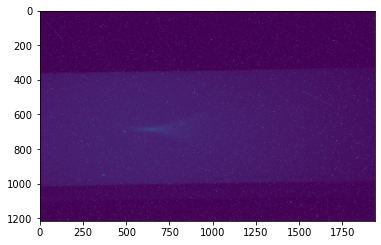

In [14]:
for i in np.arange(1100,1200,1):
    
    ex_data, protons, rif, laser, screens = load_all_event_data('2024/09/14',event_files[i],spectro_no=2,threshold=1750000)
    
    if screens['LDBP'] == 0 and screens['Plunger'] == None and rif == 1121740.937:
        print(rif, screens, laser, i)
        
        plt.imshow(ex_data)
        plt.show()

In [15]:
test_14_09_lbdp_75 = sort_by_space_scin_screen(680,1936,1159,1164,'2024/09/14',2)

In [45]:
fit_to_spectrometer_no_filter(test_14_09_lbdp_75, 5,'2024/09/14',2)

NameError: name 'fit_to_spectrometer_no_filter' is not defined

In [117]:
background_ex_nofilter_p8 = background_subtraction_nofilter('2024/09/14',1170, 2, threshold=1.75e6,stored_event=5)

NpzFile 'slope_intercept_data_2024-09-14_Spectro_2_Upto_Event_5_nofilter.npz' with keys: RIF_1121740.937_Laser_0_Screens_LDBP_slope, RIF_1121740.937_Laser_0_Screens_LDBP_intercepts
Shapes - slopes: (1216, 1936) intercepts: (1216, 1936) data: (1216, 1936)
Protons: 28.876957


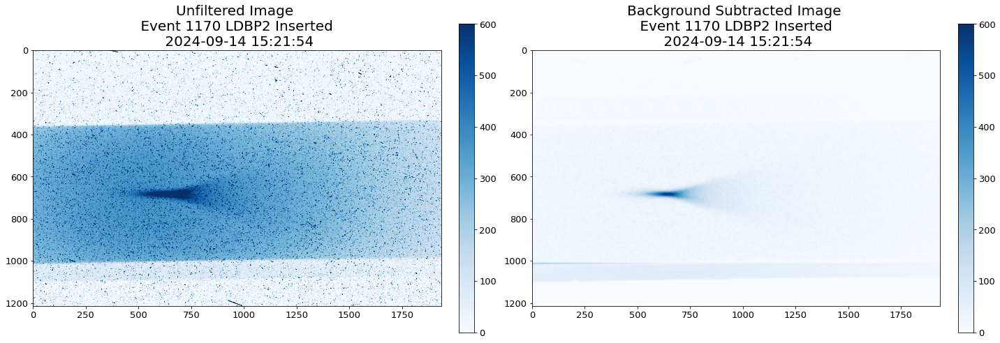

In [121]:
fig, axes = plt.subplots(1, 2, figsize=(20, 15))

selectedEvent = os.path.join(DATA_PATH, event_files[1170])
stamp = int(selectedEvent[44:63])
timestamp = pd.to_datetime(stamp)
formatted_timestamp = timestamp.strftime('%Y-%m-%d %H:%M:%S')

# EVENT 963 
# First subplot
im1 = axes[0].imshow(ex_data_plunger, cmap='Blues', vmin=0,vmax=600)
axes[0].set_title(f'Unfiltered Image \n Event 1170 LDBP2 Inserted \n {formatted_timestamp}', fontsize=20)
cbar1 = fig.colorbar(im1, ax=axes[0], fraction=0.035, pad=0.04)
cbar1.ax.tick_params(labelsize=13)


# Second subplot
im2 = axes[1].imshow(background_ex_nofilter_p8, cmap='Blues', vmin=0, vmax=600)
axes[1].set_title(f'Background Subtracted Image \n Event 1170 LDBP2 Inserted \n {formatted_timestamp}', fontsize=20)
cbar = fig.colorbar(im2, ax=axes[1], fraction=0.035, pad=0.04)
cbar.ax.tick_params(labelsize=13)

axes[1].tick_params(axis='both', which='major', labelsize=13)
axes[0].tick_params(axis='both', which='major', labelsize=13)


plt.tight_layout()
plt.show()

Text(0.5, 1.0, 'Background Subtracted Image, Event 1063, 14.09.24')

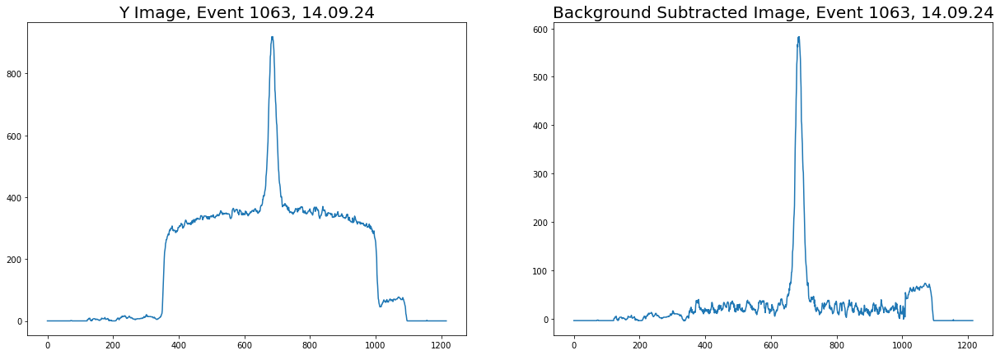

In [123]:
fig, axes = plt.subplots(1, 2, figsize=(21, 7))

x = np.arange(ex_data_plunger.shape[0])
data_w_median_filter = ski.filters.median(ex_data_plunger, footprint=disk(4)) 


## EVENT 963 
# First subplot
axes[0].plot(x,data_w_median_filter[:,650])
axes[0].set_title('Y Image, Event 1063, 14.09.24', fontsize=20)

axes[1].plot(x,background_ex_nofilter_p8[:,650])
axes[1].set_title('Background Subtracted Image, Event 1063, 14.09.24', fontsize=20)

<IPython.core.display.Javascript object>


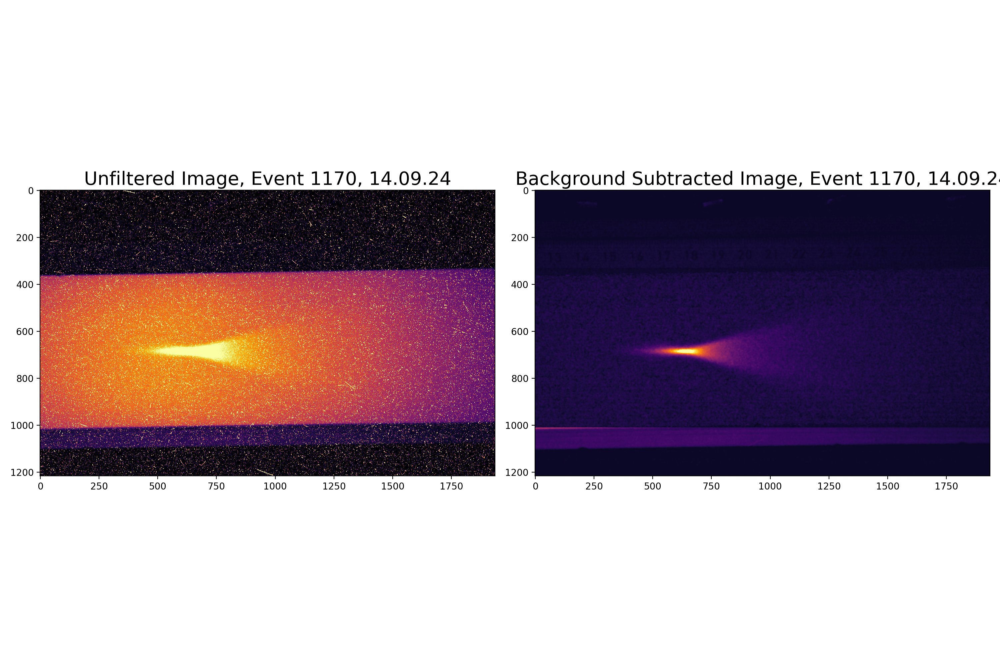

In [59]:
fig, axes = plt.subplots(1, 2, figsize=(15, 10))

## EVENT 963 
# First subplot
im1 = axes[0].imshow(ex_data_plunger, cmap='inferno', vmax=500)
axes[0].set_title('Unfiltered Image, Event 1170, 14.09.24', fontsize=20)

# Add colorbar for the first subplot
#fig.colorbar(im1, ax=axes[0])

# Second subplot
im2 = axes[1].imshow(background_ex_nofilter_p8, cmap='inferno', vmax=500)
axes[1].set_title('Background Subtracted Image, Event 1170, 14.09.24', fontsize=20)

# Add colorbar for the second subplot
#fig.colorbar(im2, ax=axes[1])

plt.tight_layout()
plt.show()

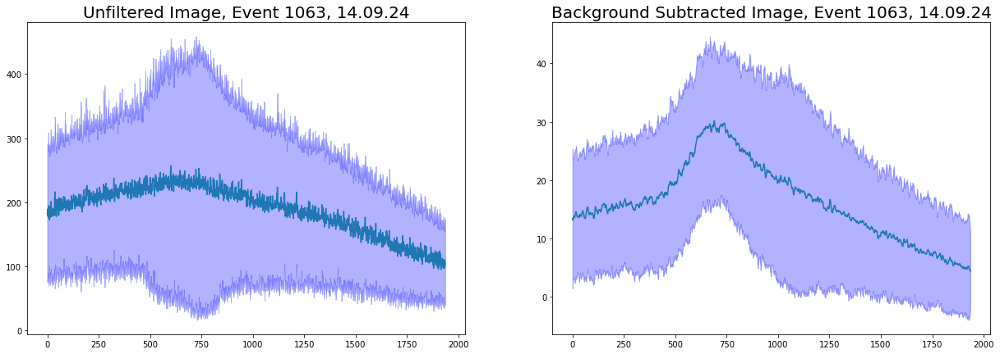

In [63]:
fig, axes = plt.subplots(1, 2, figsize=(21, 7))

median_raw = np.median(ex_data_plunger, axis=0)
mean_raw = np.mean(ex_data_plunger,0)
mad_raw = np.median(np.abs(ex_data_plunger - median_raw[None,:]), axis=0)

median_bg = np.median(background_ex_nofilter_p8, axis=0)
mad_bg = np.median(np.abs(background_ex_nofilter_p8 - median_bg[None,:]), axis=0)
mean_bg = np.mean(background_ex_nofilter_p8,0)

x = np.arange(ex_data_plunger.shape[1])

## EVENT 963 
# First subplot
axes[0].plot(x,mean_raw)
axes[0].set_title('Unfiltered Image, Event 1063, 14.09.24', fontsize=20)
axes[0].fill_between(x, mean_raw - mad_raw, mean_raw + mad_raw, alpha=0.3, label='MAD Region', color='blue')

axes[1].plot(x,mean_bg)
axes[1].set_title('Background Subtracted Image, Event 1063, 14.09.24', fontsize=20)
axes[1].fill_between(x, mean_bg - mad_bg, mean_bg + mad_bg, alpha=0.3, label='MAD Region', color='blue')

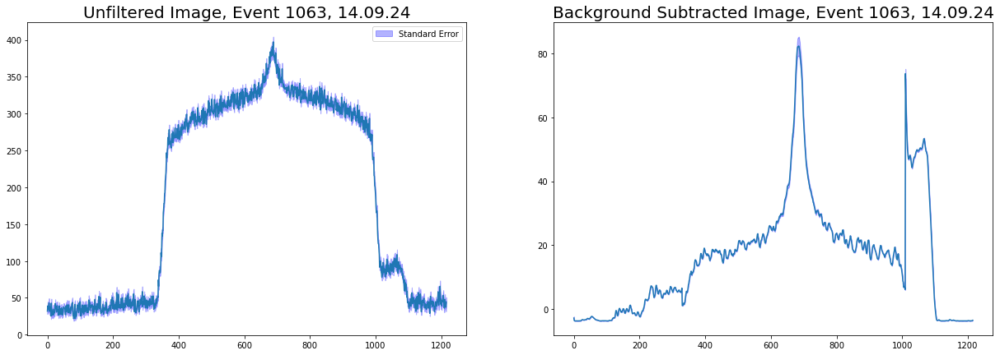

In [70]:
fig, axes = plt.subplots(1, 2, figsize=(21, 7))

mean_raw = np.mean(ex_data_plunger,1)
N = ex_data_plunger.shape[1]
std_raw = np.std(ex_data_plunger,1)/(np.sqrt(N))

std_bg = np.std(background_ex_nofilter_p8,1)/(np.sqrt(N))
mean_bg = np.mean(background_ex_nofilter_p8,1)

x = np.arange(ex_data_plunger.shape[0])

## EVENT 963 
# First subplot
axes[0].plot(x,mean_raw)
axes[0].set_title('Y Image, Event 1063, 14.09.24', fontsize=20)
axes[0].fill_between(x, mean_raw - std_raw, mean_raw + std_raw, alpha=0.3, label='Standard Error',color='blue')

axes[0].legend()

axes[1].plot(x,mean_bg)
axes[1].set_title('Background Subtracted Image, Event 1063, 14.09.24', fontsize=20)
axes[1].fill_between(x, mean_bg - std_bg, mean_bg + std_bg, alpha=0.3, label='Standard Error', color='blue')

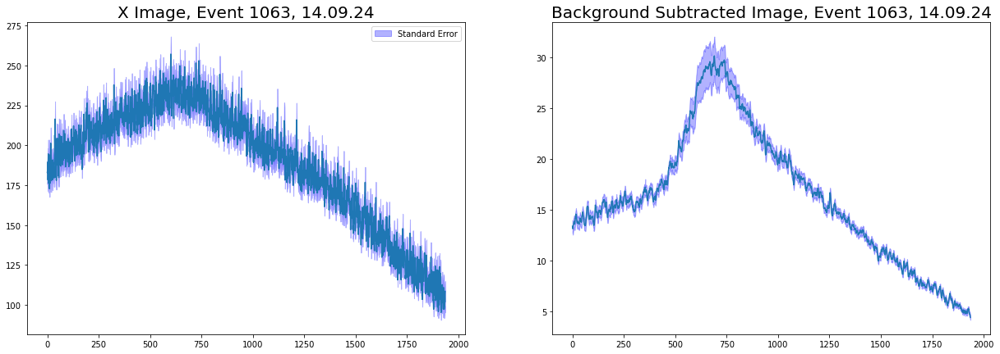

In [72]:
fig, axes = plt.subplots(1, 2, figsize=(21, 7))

mean_raw = np.mean(ex_data_plunger,0)
N = ex_data_plunger.shape[0]
std_raw = np.std(ex_data_plunger,0)/(np.sqrt(N))

std_bg = np.std(background_ex_nofilter_p8,0)/(np.sqrt(N))
mean_bg = np.mean(background_ex_nofilter_p8,0)

x = np.arange(ex_data_plunger.shape[1])

## EVENT 963 
# First subplot
axes[0].plot(x,mean_raw)
axes[0].set_title('X Image, Event 1063, 14.09.24', fontsize=20)
axes[0].fill_between(x, mean_raw - std_raw, mean_raw + std_raw, alpha=0.3, label='Standard Error',color='blue')

axes[0].legend()

axes[1].plot(x,mean_bg)
axes[1].set_title('Background Subtracted Image, Event 1063, 14.09.24', fontsize=20)
axes[1].fill_between(x, mean_bg - std_bg, mean_bg + std_bg, alpha=0.3, label='Standard Error', color='blue')

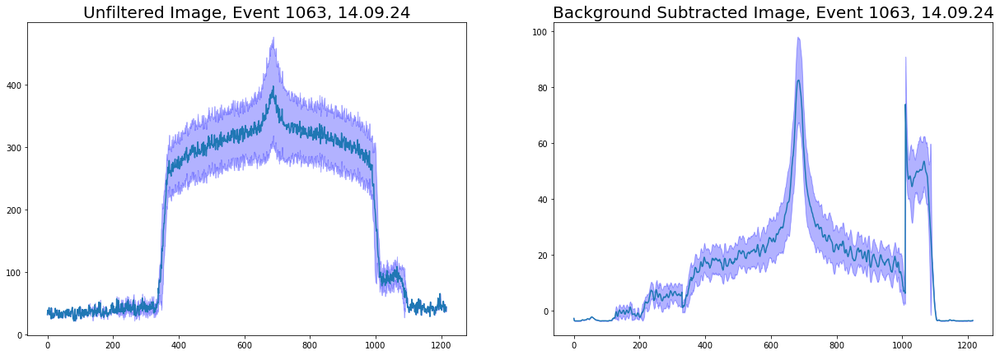

In [62]:
fig, axes = plt.subplots(1, 2, figsize=(21, 7))

median_raw = np.median(ex_data_plunger, axis=1)
mean_raw = np.mean(ex_data_plunger,1)
mad_raw = np.median(np.abs(ex_data_plunger - median_raw[:,None]), axis=1)

median_bg = np.median(background_ex_nofilter_p8, axis=1)
mad_bg = np.median(np.abs(background_ex_nofilter_p8 - median_bg[:,None]), axis=1)
mean_bg = np.mean(background_ex_nofilter_p8,1)

x = np.arange(ex_data_plunger.shape[0])

## EVENT 963 
# First subplot
axes[0].plot(x,mean_raw)
axes[0].set_title('Unfiltered Image, Event 1063, 14.09.24', fontsize=20)
axes[0].fill_between(x, mean_raw - mad_raw, mean_raw + mad_raw, alpha=0.3, label='MAD Region', color='blue')

axes[1].plot(x,mean_bg)
axes[1].set_title('Background Subtracted Image, Event 1063, 14.09.24', fontsize=20)
axes[1].fill_between(x, mean_bg - mad_bg, mean_bg + mad_bg, alpha=0.3, label='MAD Region', color='blue')